In [1]:
import os
import shutil
import sys

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

sys.path.append(
    '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_rdoc'
)

%load_ext autoreload
%autoreload 2
from utils import (
    calc_avg_prob_next_given_last1_and_last2,
    calc_expected_run_num_by_chance,
    est_psych_fitness,
)

## How models were chosen

This is our first time using this set of psychological assessment measures, along with efficiency and VIF, to select the best designs.  `prob_runs_gte2` is the probability of having equal to or larger than 2 conditions in a row and we decided not to choose designs that minimize this measure because it wouldn't work well when there are only 2 conditions as it would favor alternating the two conditions.  `kao_meas` and `run_num_diff_from_avg` both compare pattern occurrences in a given design to what is expected by chance (minimizing this is the goal).  The actual measure is the sum of the absolute differences.  The `prob_next_given_last1` and `prob_next_given_last2` are the max conditional probabilities estimated using the given design's trial order (e.g., estimate prob(current|last) for each condition pair and take the max)  Patrick was curious whether this measure would be better if it instead was a sum of absolute differences.  Both styles if measures have pros and cons.  We did compare and there wasn't much change when `max_diff_prob_next_given_last1`/`max_diff_prob_next_given_last2` were used instead of or in addition to the max conditional probability measures, so we stuck with the original plan and just used `prob_next_given_last1`/`prob_next_given_last2`, the max probability measures.

We also used `scan_length`, the vif's and minimized efficiency.  For each measure they were ranked from best to worst.  Then the top X designs within each measure were selected and the overlap of these designs was checked.  The value of X was increased until the overlap set contained the desired number of designs.

In [2]:
# simulation output data location.  This dataset was generated on Sherlock and copied to my local machine to run this.
outdir = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_output/'


def get_events_eff_data(outdir, task):
    events_all = []
    for i in range(1, 6):
        events = pd.read_pickle(f'{outdir}/{task}_events_{i}.pkl')
        events_all.extend(events)

    output_list = []

    for i in range(1, 6):
        output_list.append(pd.read_csv(f'{outdir}/{task}_output_{i}.csv'))
    output_all = pd.concat(output_list, ignore_index=True)
    output_all = output_all.loc[:, ~output_all.columns.str.contains('^Unnamed')]
    ranks = {col: np.argsort(output_all[col].to_numpy()) for col in output_all.columns}
    return events_all, output_all, ranks

In [3]:
def draw_histograms(output, overlap_array, variables, n_rows, n_cols, title=None):
    """
    Plots histogram and location of top model picks
    """
    line_colors = sns.color_palette('bright', len(overlap_array))
    fig = plt.figure(figsize=(12, 12))
    if title is not None:
        plt.suptitle(title)
    for i, var_name in enumerate(variables):
        ax = fig.add_subplot(n_rows, n_cols, i + 1)
        ax.hist(output[var_name], 100, color='lightgray')
        if 'vif' in var_name:
            ax.axvline(x=5, color='black', linewidth=2)
        for color_ind, index in enumerate(overlap_array):
            ax.axvline(
                x=output[var_name][index],
                color=line_colors[color_ind],
                linewidth=1,
                label=index,
            )
        ax.set_title(var_name)
        if len(overlap_array) <= 12:
            ax.legend(fontsize=7)
    fig.tight_layout()
    plt.show()

In [4]:
# Where chosen design are saved
root = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_rdoc/final_designs'


def save_chosen_events_files(task, output, events, overlap_array, root):
    outdir = f'{root}/{task}'
    if os.path.exists(outdir):
        shutil.rmtree(outdir)
    os.makedirs(outdir)
    for save_index in overlap_array:
        events[save_index].to_csv(f'{outdir}/{task}_events_{save_index}.csv')
    output_save = output.loc[overlap_array, :]
    output_save.to_csv(f'{outdir}/{task}_model_assessment_values.csv')

In [5]:
def choose_designs(
    output,
    ranks,
    choice,
    n_des,
    task_name,
    psych_meas,
    make_grid_plot=True,
    top_number=1000,
    add_amount=5000,
):
    if make_grid_plot:
        g = sns.PairGrid(output.loc[:500, :])
        g.map_diag(sns.histplot)
        g.map_offdiag(sns.scatterplot)
        plt.show()

    best_high = [name for name in output.columns if 'eff' in name]
    if choice == 'sum_measure_only':
        best_low = (
            [name for name in output.columns if 'vif' in name]
            + psych_meas
            + [
                'sum_abs_diff_prob_next_given_last1',
                'sum_abs_diff_prob_next_given_last2',
            ]
        )
        all_labels_hist = (
            best_high
            + [name for name in output if 'vif' in name]
            + psych_meas
            + [
                'prob_next_given_last1',
                'prob_next_given_last2',
                'sum_abs_diff_prob_next_given_last1',
                'sum_abs_diff_prob_next_given_last2',
            ]
        )
    if choice == 'max_measure_only':
        best_low = (
            [name for name in output.columns if 'vif' in name]
            + psych_meas
            + ['prob_next_given_last1', 'prob_next_given_last2']
        )
        all_labels_hist = (
            best_high
            + [name for name in output if 'vif' in name]
            + psych_meas
            + [
                'prob_next_given_last1',
                'prob_next_given_last2',
                'sum_abs_diff_prob_next_given_last1',
                'sum_abs_diff_prob_next_given_last2',
            ]
        )
    if choice == 'both':
        best_low = (
            [name for name in output.columns if 'vif' in name]
            + psych_meas
            + [
                'prob_next_given_last1',
                'prob_next_given_last2',
                'sum_abs_diff_prob_next_given_last1',
                'sum_abs_diff_prob_next_given_last2',
            ]
        )
        all_labels_hist = (
            best_high
            + [name for name in output if 'vif' in name]
            + psych_meas
            + [
                'prob_next_given_last1',
                'prob_next_given_last2',
                'sum_abs_diff_prob_next_given_last1',
                'sum_abs_diff_prob_next_given_last2',
            ]
        )
    if choice == 'neither':
        best_low = [name for name in output.columns if 'vif' in name] + psych_meas
        all_labels_hist = (
            best_high + [name for name in output if 'vif' in name] + psych_meas
        )

    len_overlap_set = 0

    while len_overlap_set < n_des:
        overlap_set = set(output.index)
        for high_label in best_high:
            overlap_set = set.intersection(overlap_set, ranks[high_label][-top_number:])
        for low_label in best_low:
            overlap_set = set.intersection(overlap_set, ranks[low_label][:top_number])
        len_overlap_set = len(overlap_set)
        old_top_number = top_number
        if len_overlap_set < n_des:
            top_number = top_number + add_amount
        if len_overlap_set > n_des:
            add_amount = int(np.floor(add_amount / 2))
            top_number = top_number - add_amount
            len_overlap_set = 0
        if len_overlap_set == n_des:
            break
        if old_top_number == top_number:
            print('Exact number of designs not possible, so there are extras')
            break
        if len_overlap_set > len(ranks['scan_length']):
            print('Not enough data to find designs')
            return None

    nrows_plot = int(np.ceil(len(all_labels_hist) / 5))
    draw_histograms(
        output,
        overlap_set,
        all_labels_hist,
        5,
        nrows_plot,
        title=f'{task_name} using {choice}',
    )
    print(overlap_set)
    return overlap_set

## Flanker and Stroop

In [6]:
events_flanker_stroop, output_flanker_stroop, ranks_flanker_stroop = (
    get_events_eff_data(outdir, 'flanker_stroop')
)

In [7]:
# check that all simulations ran
print(output_flanker_stroop.shape)

(100000, 16)


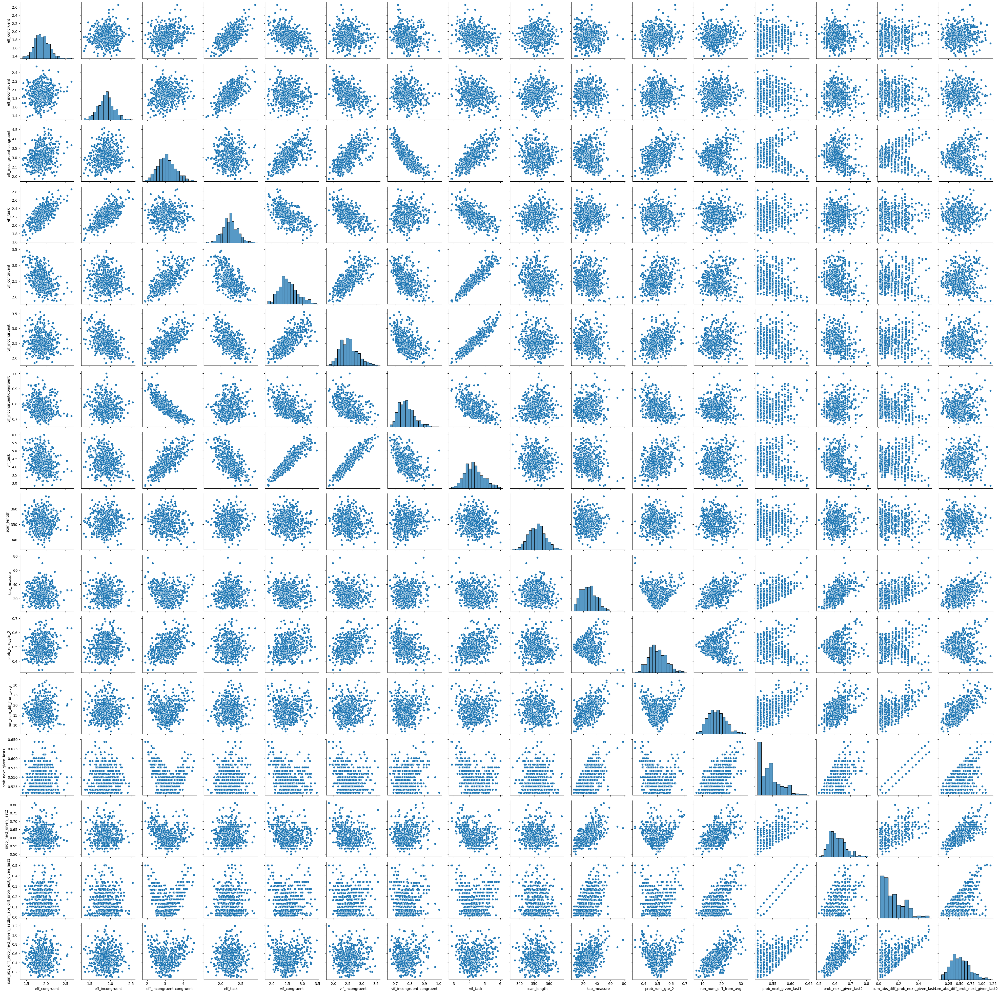

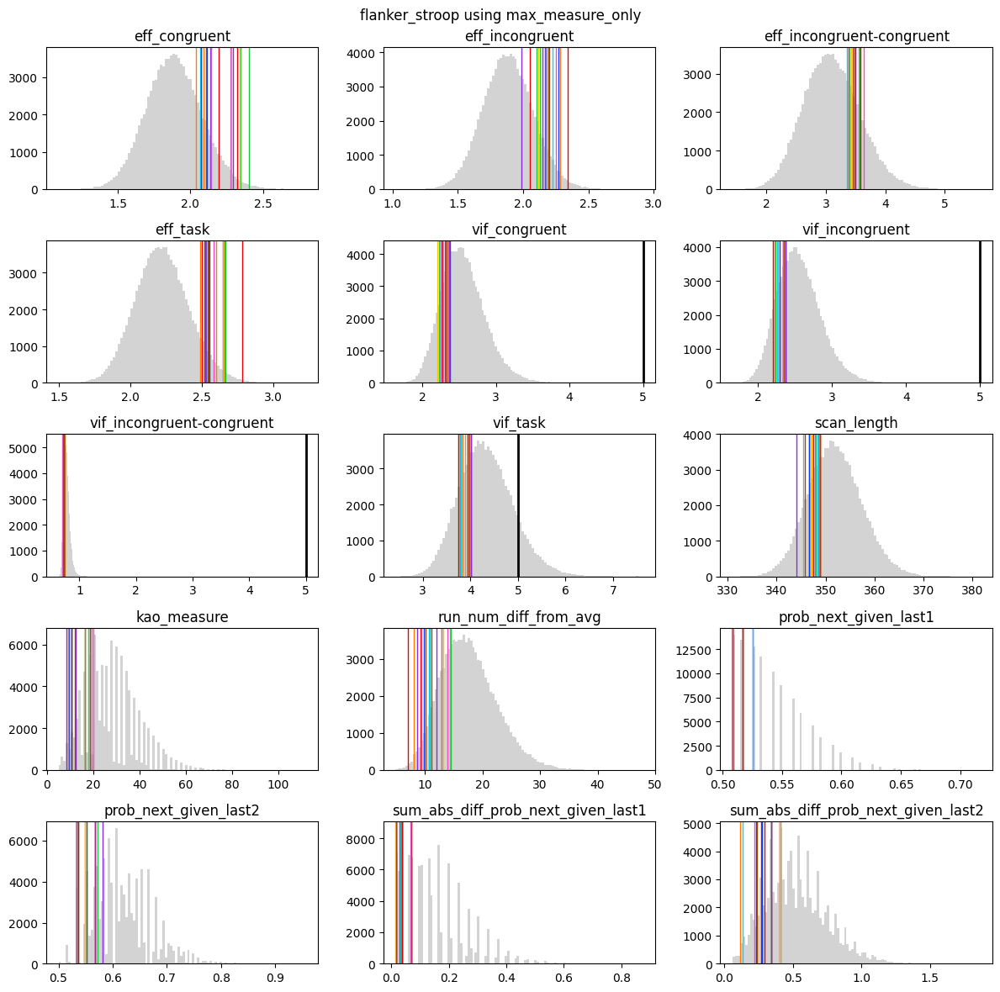

{8293, 72293, 85221, 52395, 15662, 7023, 70647, 85015, 19828, 97750, 9111, 92665, 98874, 1850, 34461, 40279, 75199}


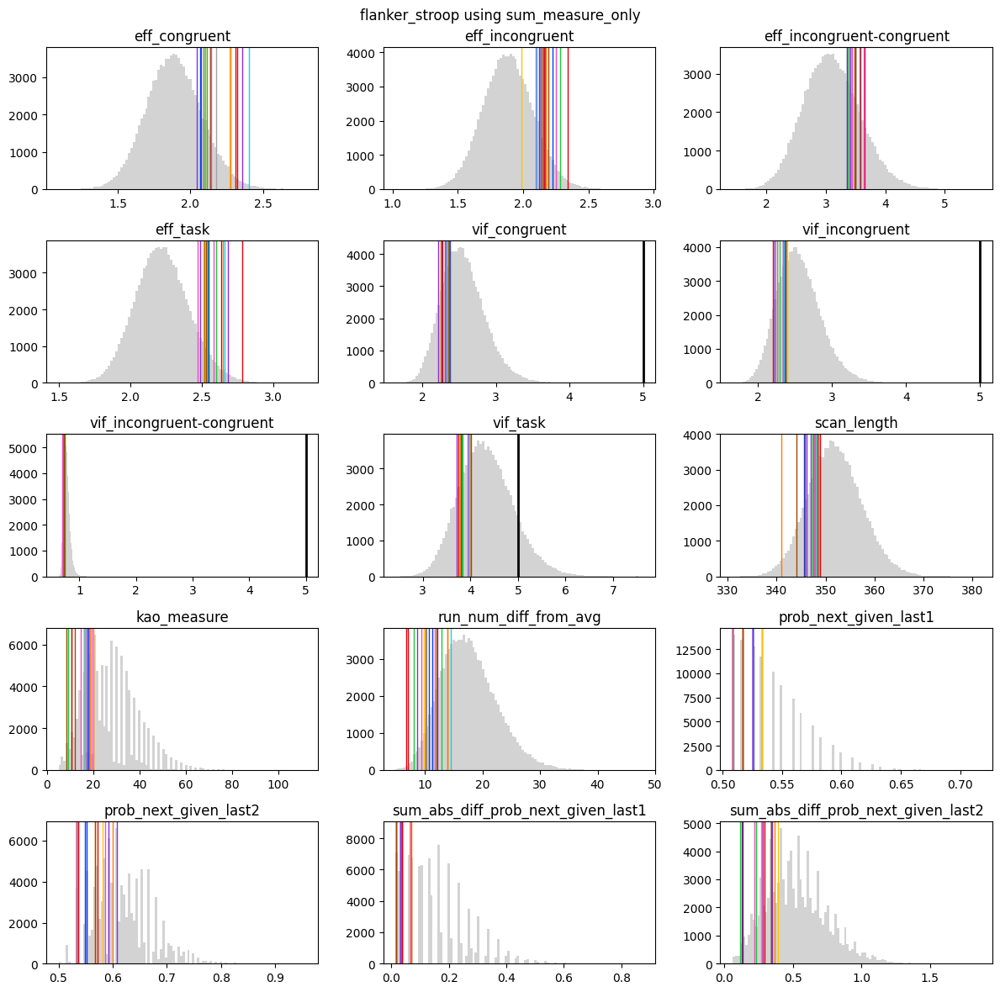

{32256, 93728, 8293, 85222, 85575, 7023, 76880, 86482, 2706, 98874, 97750, 70647, 92665, 1850, 76924, 34461, 75199}


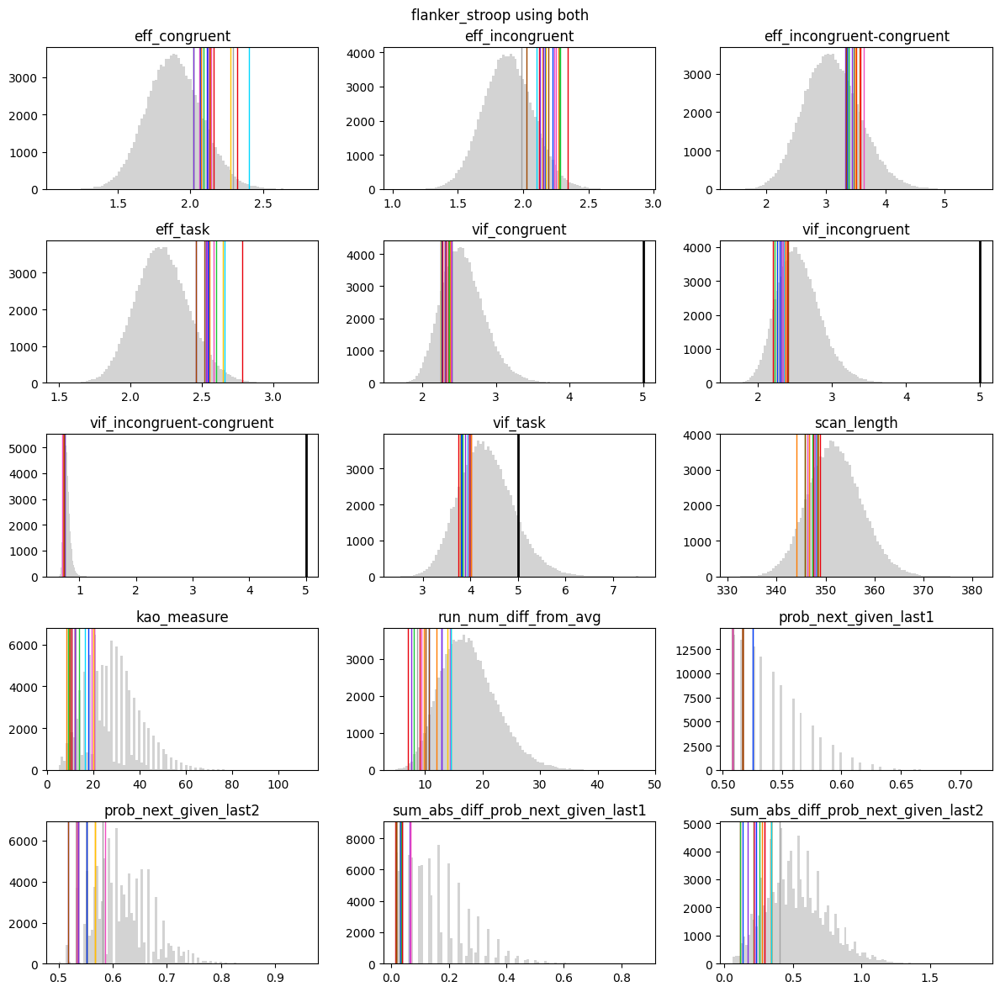

{8293, 34461, 43688, 16010, 34574, 7023, 74170, 15662, 70647, 98874, 97750, 9111, 92665, 1850, 69564, 56253, 75199}


In [8]:
task = 'flanker_stroop'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_flanker_stroop = {}

n_choose = 17

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_flanker_stroop[choice] = choose_designs(
            output_flanker_stroop,
            ranks_flanker_stroop,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=True,
        )
    else:
        overlaps_flanker_stroop[choice] = choose_designs(
            output_flanker_stroop,
            ranks_flanker_stroop,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [9]:
save_chosen_events_files(
    'flanker_stroop',
    output_flanker_stroop,
    events_flanker_stroop,
    list(overlaps_flanker_stroop['max_measure_only']),
    root,
)

## GoNoGo

In [10]:
events_gng, output_gng, ranks_gng = get_events_eff_data(outdir, 'gng')

In [11]:
print(output_gng.shape)

(100000, 16)


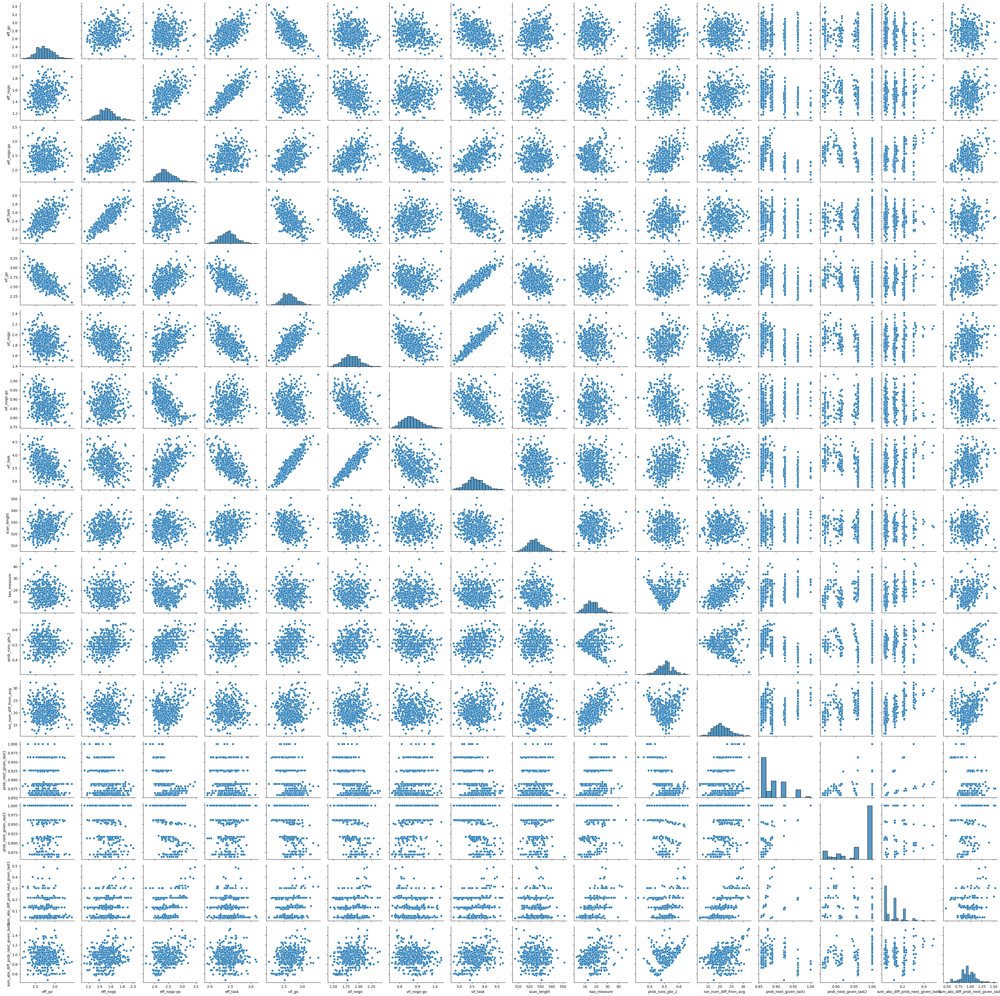

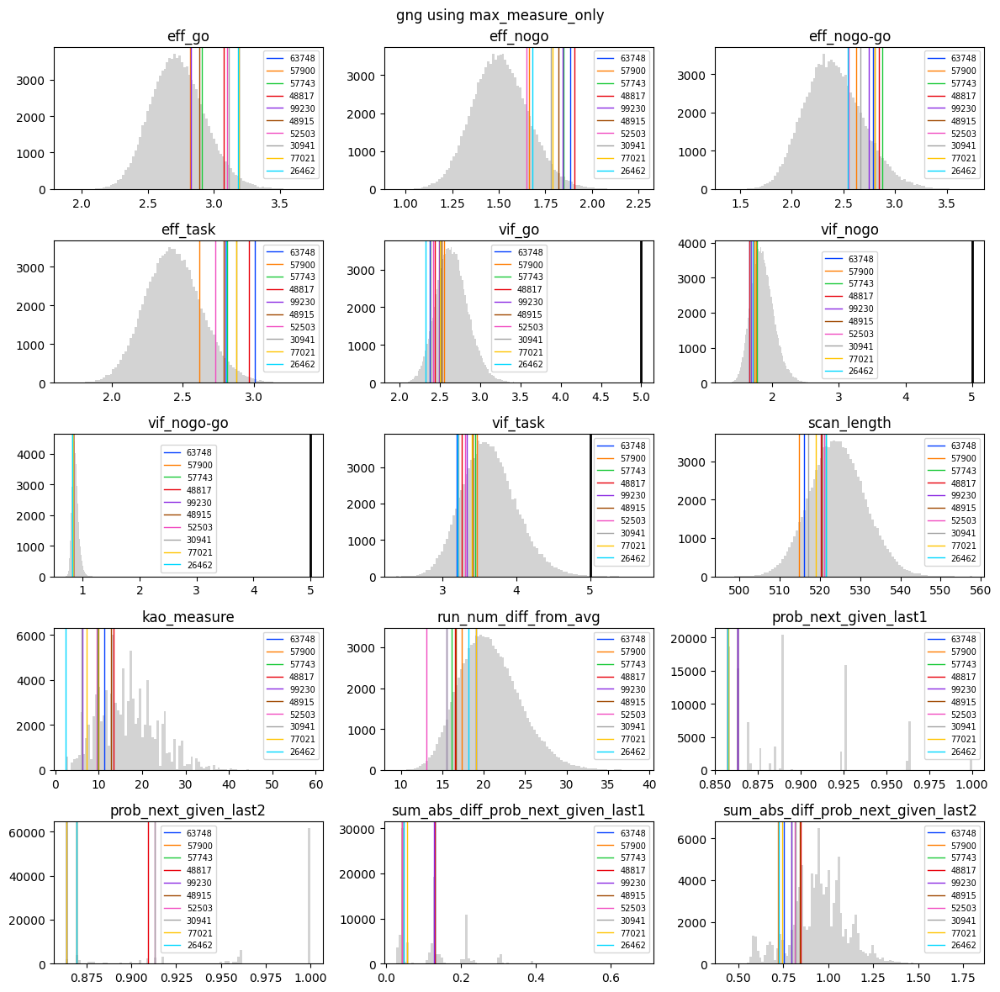

{63748, 57900, 57743, 48817, 99230, 48915, 52503, 30941, 77021, 26462}


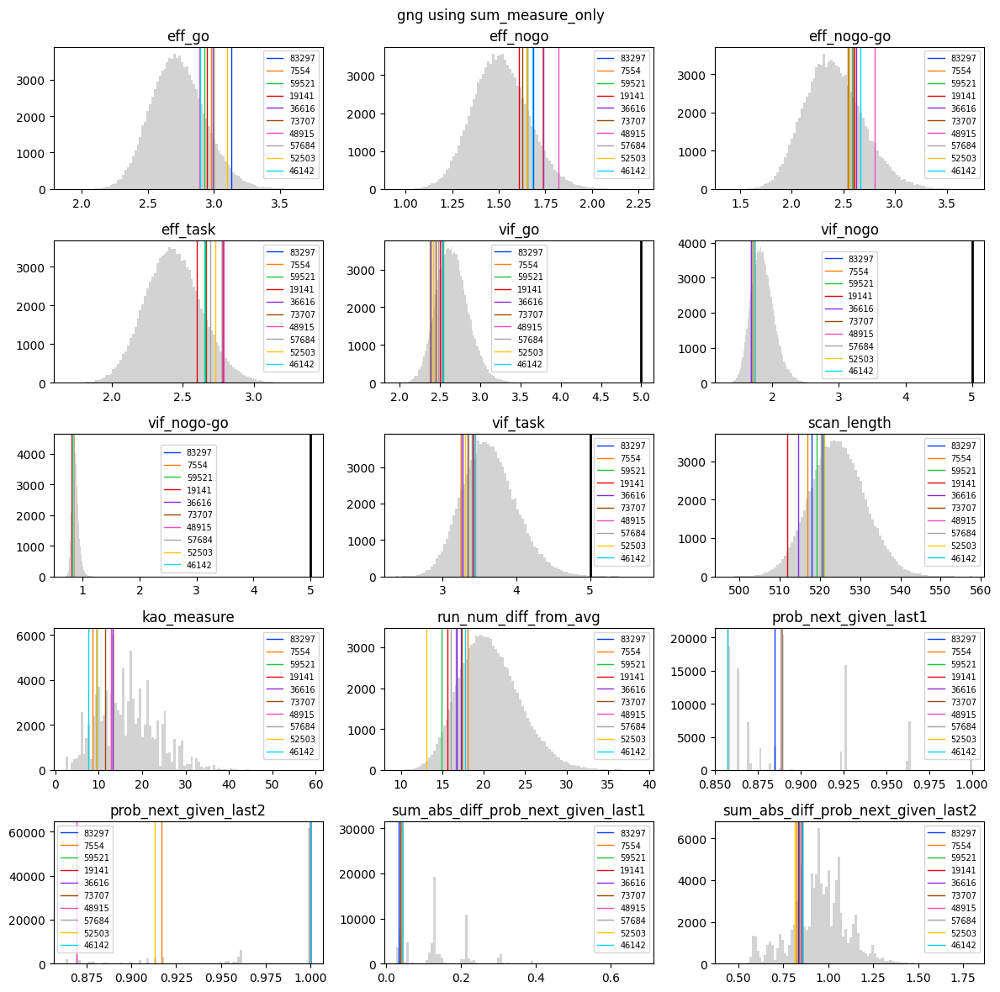

{83297, 7554, 59521, 19141, 36616, 73707, 48915, 57684, 52503, 46142}


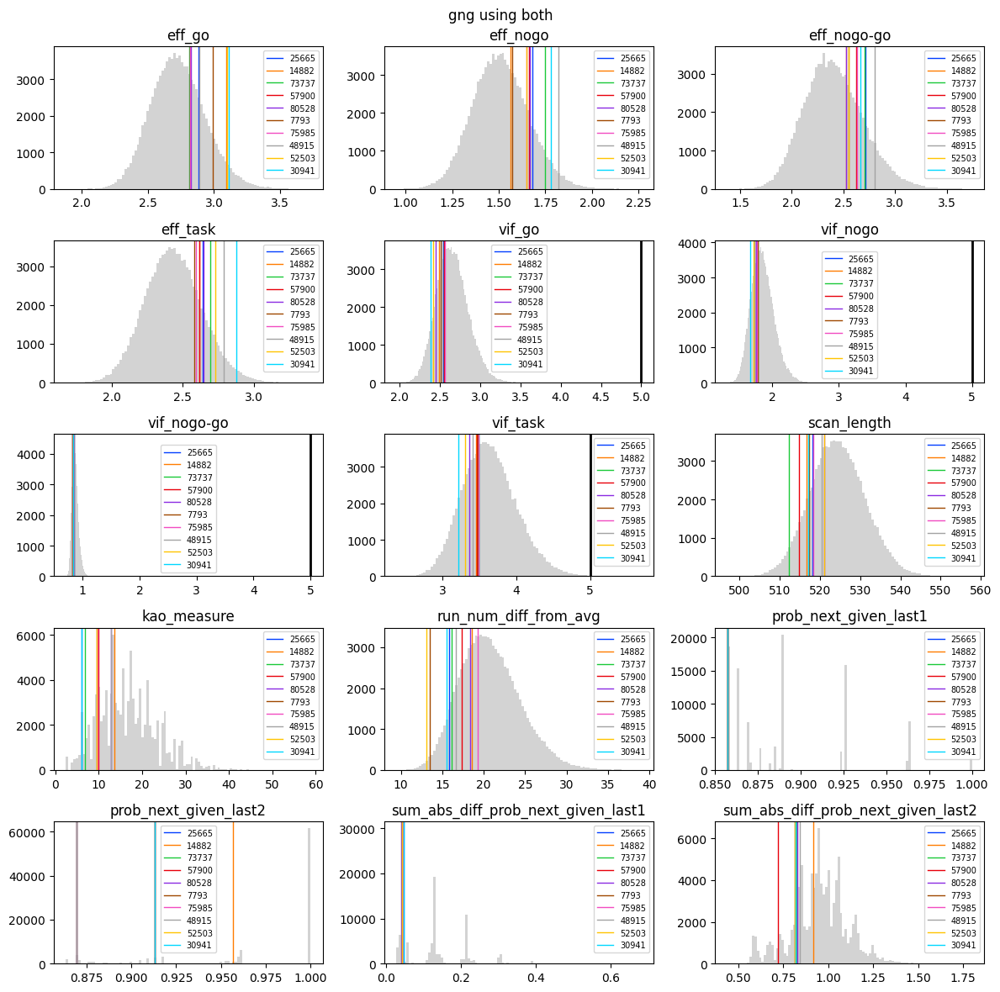

{25665, 14882, 73737, 57900, 80528, 7793, 75985, 48915, 52503, 30941}


In [12]:
task = 'gng'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_gng = {}
n_choose = 10

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_gng[choice] = choose_designs(
            output_gng,
            ranks_gng,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=True,
        )
    else:
        overlaps_gng[choice] = choose_designs(
            output_gng,
            ranks_gng,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )


In [13]:
save_chosen_events_files(
    'gng', output_gng, events_gng, list(overlaps_gng['max_measure_only']), root
)

## Stop signal

In [14]:
events_stop_signal, output_stop_signal, ranks_stop_signal = get_events_eff_data(
    outdir, 'stop_signal'
)

In [15]:
print(output_stop_signal.shape)

(100000, 16)


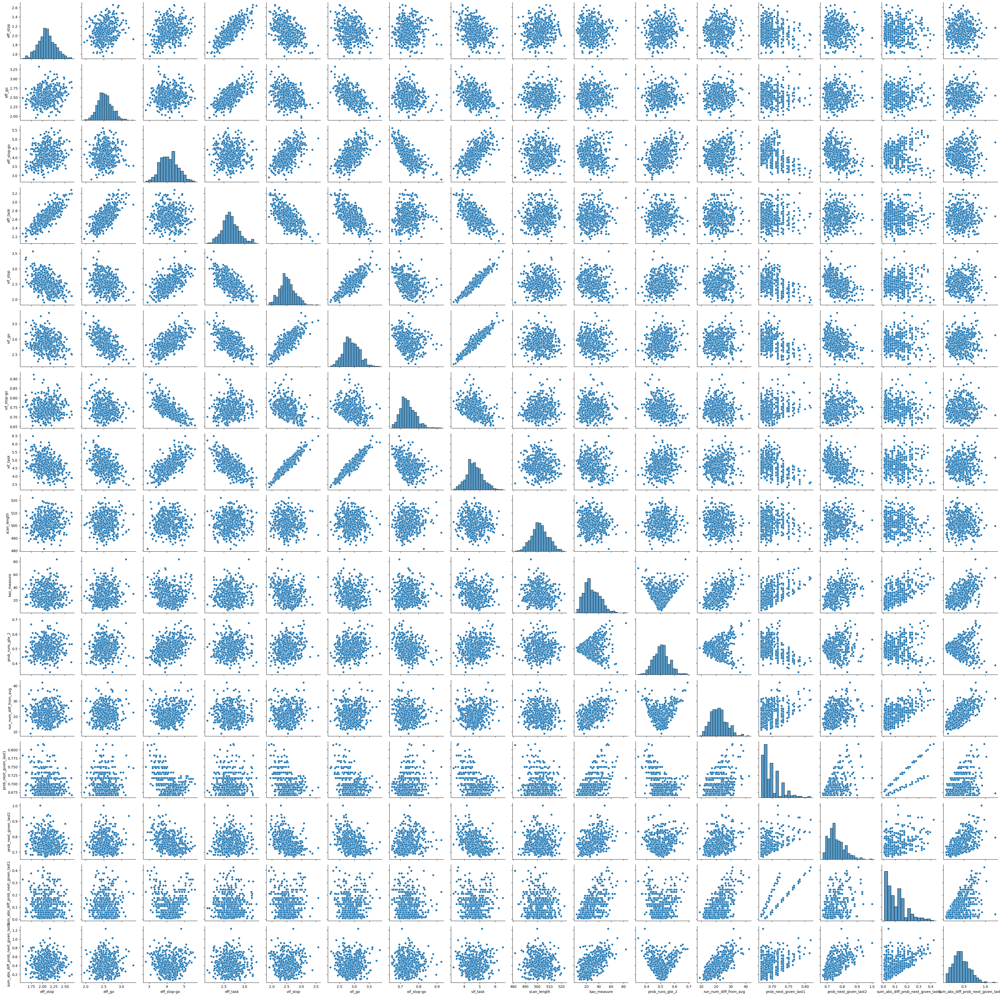

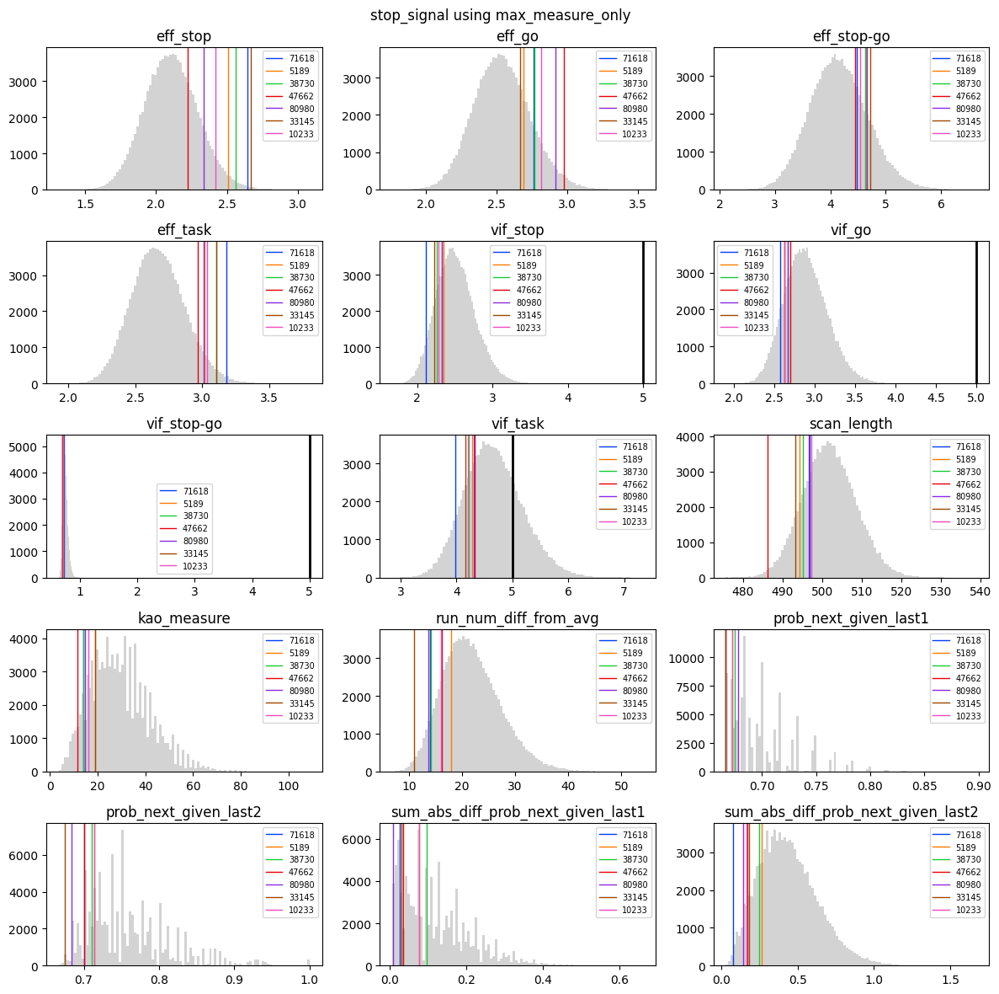

{71618, 5189, 38730, 47662, 80980, 33145, 10233}


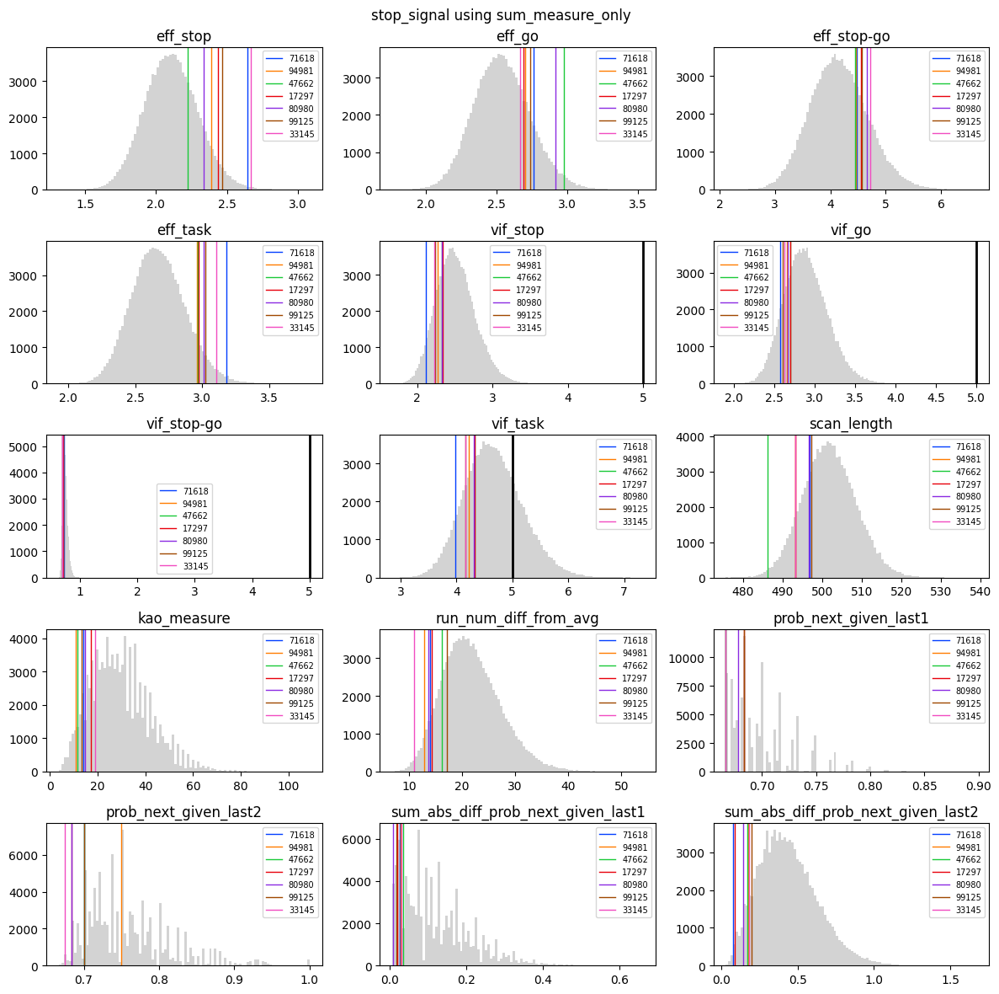

{71618, 94981, 47662, 17297, 80980, 99125, 33145}


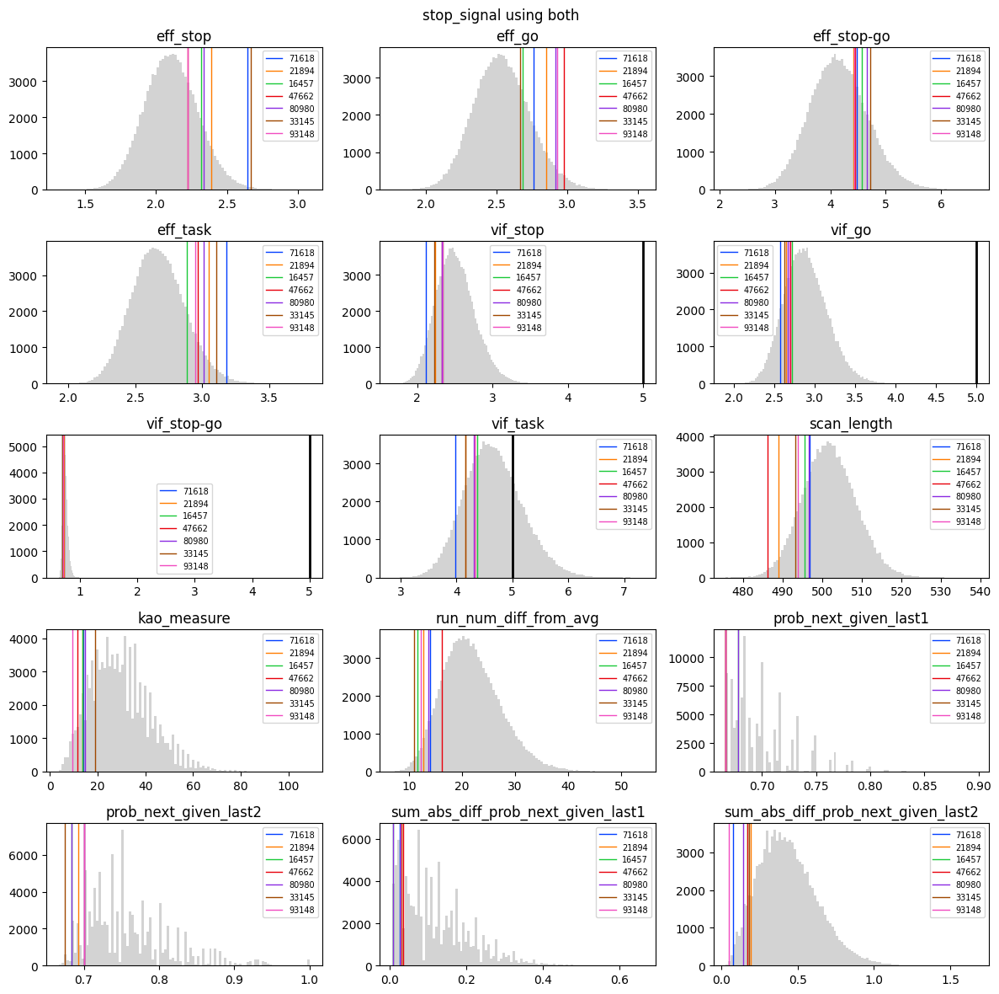

{71618, 21894, 16457, 47662, 80980, 33145, 93148}


In [16]:
task = 'stop_signal'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_stop_signal = {}
n_choose = 7
for choice in choices:
    if choice == 'max_measure_only':
        overlaps_stop_signal[choice] = choose_designs(
            output_stop_signal,
            ranks_stop_signal,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=True,
        )
    else:
        overlaps_stop_signal[choice] = choose_designs(
            output_stop_signal,
            ranks_stop_signal,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [17]:
save_chosen_events_files(
    'stop_signal',
    output_stop_signal,
    events_stop_signal,
    list(overlaps_stop_signal['max_measure_only']),
    root,
)

## AX CPT

## Changes made for model selection

For AX-CPT, the psychological measures stored are based on treating AX/AY/BX/BY as the four different trial types of interest, but this doesn't control whether or not there are too many, for example, A trials in a row.  What is done here is first 30 good designs are chosen based on the max measure only, using the original 4 trial splits.  Then, on these 30 designs only, new psychological measures are calculated to assess the A/B trial ordering (ignoring X/Y).

In [18]:
events_ax_cpt, output_ax_cpt, ranks_ax_cpt = get_events_eff_data(outdir, 'ax_cpt')

In [19]:
print(output_ax_cpt.shape)

(100000, 20)


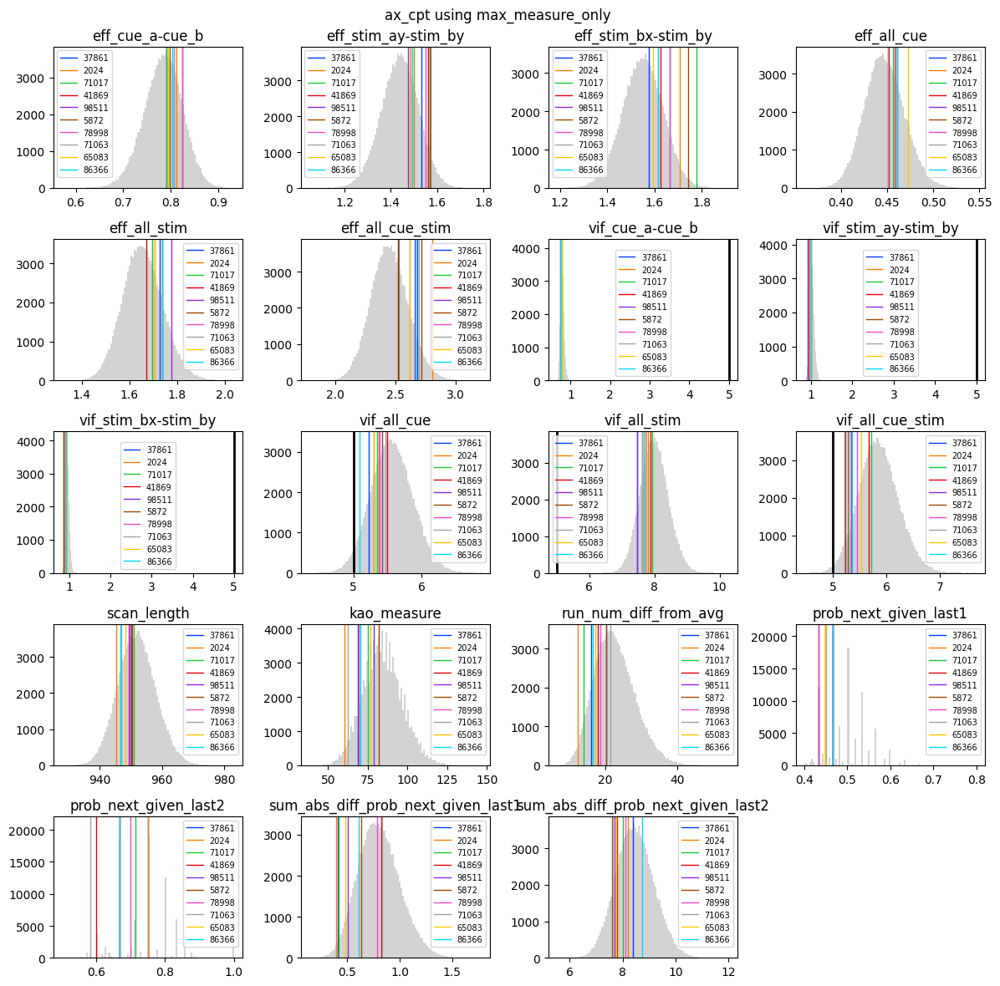

{37861, 2024, 71017, 41869, 98511, 5872, 78998, 71063, 65083, 86366}


In [20]:
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only']
overlaps_ax_cpt = {}

ndesigns = 10

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt[choice] = choose_designs(
            output_ax_cpt,
            ranks_ax_cpt,
            choice,
            ndesigns,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [21]:
save_chosen_events_files(
    'ax_cpt',
    output_ax_cpt,
    events_ax_cpt,
    list(overlaps_ax_cpt['max_measure_only']),
    root,
)

### AX-CPT second option

Here I begin with the original designs, where the psych measures are based on all 4 trial types AX/AY/BX/BY.  I first choose the top 500 designs using those metrics and within those I do a secondary search based on the A/B labels, alone.

In [22]:
events_ax_cpt_4lev, output_ax_cpt_4lev, ranks_ax_cpt_4lev = get_events_eff_data(
    outdir, 'ax_cpt'
)

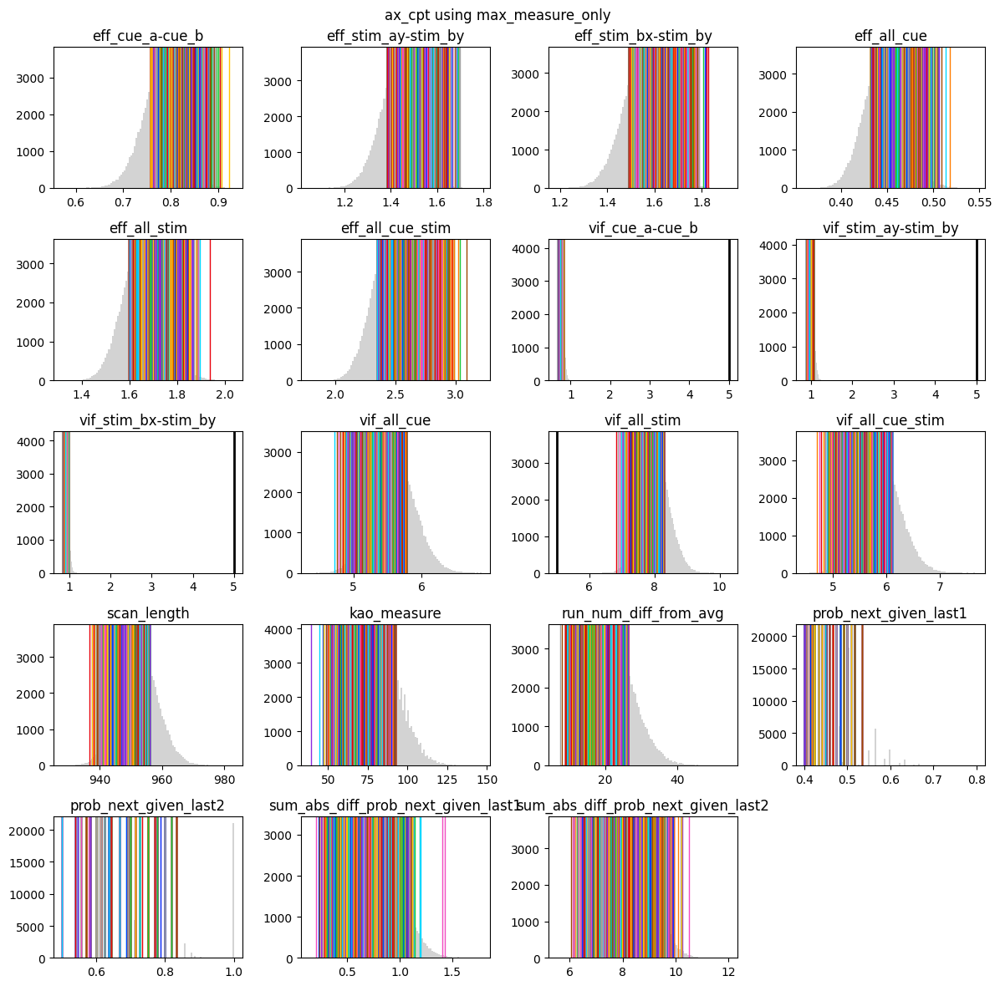

{98332, 29, 36, 56, 65599, 65600, 32833, 65602, 65606, 32839, 81, 32849, 32861, 65633, 98438, 32906, 148, 154, 98466, 171, 98487, 32951, 98495, 32962, 32963, 196, 98511, 98515, 214, 98520, 32999, 98550, 65789, 33022, 98560, 65793, 286, 98593, 98602, 65836, 304, 305, 98610, 33084, 33087, 33102, 65872, 98647, 343, 65888, 65889, 65900, 33134, 33137, 65907, 65918, 33160, 393, 98707, 65943, 98713, 33189, 422, 65974, 98745, 98760, 98762, 33242, 33245, 479, 98789, 486, 66021, 503, 66049, 98821, 33292, 98831, 98839, 33308, 66083, 98853, 98858, 554, 66092, 558, 98864, 66102, 33336, 98884, 33349, 33358, 594, 33365, 598, 601, 33372, 33375, 608, 33378, 33393, 627, 33395, 98934, 634, 642, 98948, 33415, 98959, 663, 66202, 98976, 66209, 33445, 679, 680, 685, 98993, 98997, 33462, 66230, 98998, 33478, 66253, 66256, 99027, 33492, 33493, 99028, 66267, 99044, 99045, 745, 754, 756, 99061, 66295, 99063, 99067, 66300, 99071, 66313, 99085, 99090, 787, 33562, 99124, 33593, 33608, 66383, 66387, 855, 66394, 3363

In [23]:
# Choose top 500, using ax/ay/bx/by trial type split
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only']
overlaps_ax_cpt_4lev = {}

ndesigns = 5000

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt_4lev[choice] = choose_designs(
            output_ax_cpt_4lev,
            ranks_ax_cpt_4lev,
            choice,
            ndesigns,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [24]:
trials_psych_assess_map = {
    'stim_ax': '1',
    'stim_ay': '1',
    'stim_bx': '2',
    'stim_by': '2',
}

events_inputs_delay_jitter_no_deriv = {
    'n_ax': 60,
    'n_ay': 30,
    'n_bx': 30,
    'n_by': 30,
    'nbreaks': 2,
    'cue_dur': 0.5,
    'delay_dur': 'jittered3',
    'stim_dur': 1,
    'blank_dur': 0.5,
    'break_fix_pre_message_dur': 6,
    'break_message_dur': 4,
    'break_fix_post_message_dur': 6,
    'isi_exp_lam': 2,
    'isi_truncation': 4.5,
    'isi_shift': 0.5,
}

unpermuted_trials = np.concatenate(
    [
        np.repeat('1', events_inputs_delay_jitter_no_deriv['n_ax'] / 3),
        np.repeat('1', events_inputs_delay_jitter_no_deriv['n_ay'] / 3),
        np.repeat('2', events_inputs_delay_jitter_no_deriv['n_bx'] / 3),
        np.repeat('2', events_inputs_delay_jitter_no_deriv['n_by'] / 3),
    ],
    axis=0,
)
avg_trial_repeats_info = calc_expected_run_num_by_chance(unpermuted_trials, nsims=5000)
for val in ['1', '2']:
    avg_trial_repeats_info[f'{val}_run_counts'] = (
        avg_trial_repeats_info[f'{val}_run_counts'] * 3
    )
avg_prob_given_last1, avg_prob_given_last2 = calc_avg_prob_next_given_last1_and_last2(
    unpermuted_trials
)


In [25]:
# Set up output psych measures for the ab labels
contrasts = {
    'cue_a-cue_b': 'cue_a - cue_b',
    'stim_ay-stim_by': 'stim_ay-stim_by',
    'stim_bx-stim_by': 'stim_bx-stim_by',
    'all_cue': '.5*cue_a + .5*cue_b',
    'all_stim': '.25*stim_ax + .25*stim_ay + .25*stim_bx + .25*stim_by',
    'all_cue_stim': '1/6*cue_a +  1/6*cue_b + 1/6*stim_ax + 1/6*stim_ay + 1/6*stim_bx + 1/6*stim_by',
}
psych_variables = [
    'kao_measure',
    'prob_runs_gte_2',
    'run_num_diff_from_avg',
    'prob_next_given_last1',
    'prob_next_given_last2',
    'sum_abs_diff_prob_next_given_last1',
    'sum_abs_diff_prob_next_given_last2',
]
output_ab = {f'eff_{contrast_name}': [] for contrast_name in contrasts.keys()}
for contrast_name in contrasts.keys():
    output_ab[f'vif_{contrast_name}'] = []
output_ab['scan_length'] = []
for var in psych_variables:
    output_ab[var] = []
output_ab['design_index'] = []


for index in overlaps_ax_cpt_4lev['max_measure_only']:
    events = events_ax_cpt_4lev[index]
    output_ab['design_index'].append(index)
    trials_psych_assess = events['trial_type'][
        events['trial_type'].isin(trials_psych_assess_map)
    ]
    trials_psych_assess_coded = np.array(
        trials_psych_assess.replace(trials_psych_assess_map)
    )
    psych_assess = est_psych_fitness(
        trials_psych_assess_coded,
        avg_trial_repeats_info,
        avg_prob_given_last1,
        avg_prob_given_last2,
    )
    for key, val in psych_assess.items():
        output_ab[key].append(val)
    for key in output_ab.keys():
        if 'eff' in key:
            output_ab[key].append(output_ax_cpt_4lev[key][index])
        if 'vif' in key:
            output_ab[key].append(output_ax_cpt_4lev[key][index])
        if 'scan_length' in key:
            output_ab[key].append(output_ax_cpt_4lev['scan_length'][index])

output_ab_df = pd.DataFrame(output_ab)
ranks_ab = {
    col: np.argsort(output_ab_df[col].to_numpy()) for col in output_ab_df.columns
}


# The values in rank_ab refer to the row numbers in output_ab_df and I'd like that to instead be the row numbers in output_ax_cpt

translate_ab_index_to_original_index = {}
for i, index in enumerate(output_ab_df['design_index']):
    translate_ab_index_to_original_index[i] = index

ranks_ab_orig_order = {}
for key in ranks_ab.keys():
    ranks_ab_orig_order[key] = [
        translate_ab_index_to_original_index[i] for i in ranks_ab[key]
    ]

output_ab_df2 = output_ab_df.set_index(output_ab_df['design_index'].copy().values)


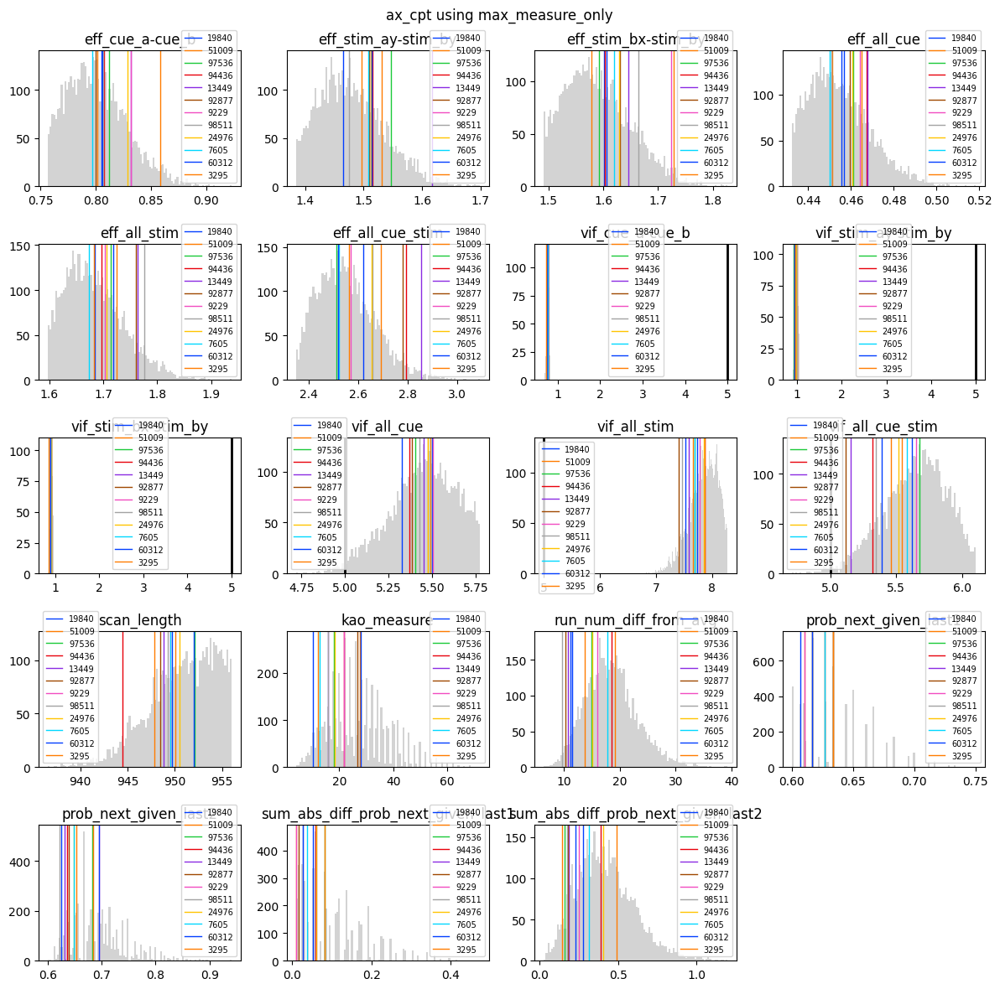

{19840, 51009, 97536, 94436, 13449, 92877, 9229, 98511, 24976, 7605, 60312, 3295}


In [26]:
# now choose top 12 from the top 5000, but now using the A/B trial type split
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only']
overlaps_ax_cpt = {}

ndesigns = 12

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt[choice] = choose_designs(
            output_ab_df2,
            ranks_ab_orig_order,
            choice,
            ndesigns,
            task,
            base_psych_meas,
            make_grid_plot=False,
            top_number=100,
            add_amount=50,
        )

In [27]:
save_chosen_events_files(
    'ax_cpt_4lev_first_2lev_second',
    output_ab_df2,
    events_ax_cpt_4lev,
    list(overlaps_ax_cpt['max_measure_only']),
    root,
)

## Cued TS and Spatial TS

In [28]:
events_cued_ts_spatial_ts, output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts = (
    get_events_eff_data(outdir, 'cued_ts_spatial_ts')
)

In [29]:
print(output_cued_ts_spatial_ts.shape)

(100000, 14)


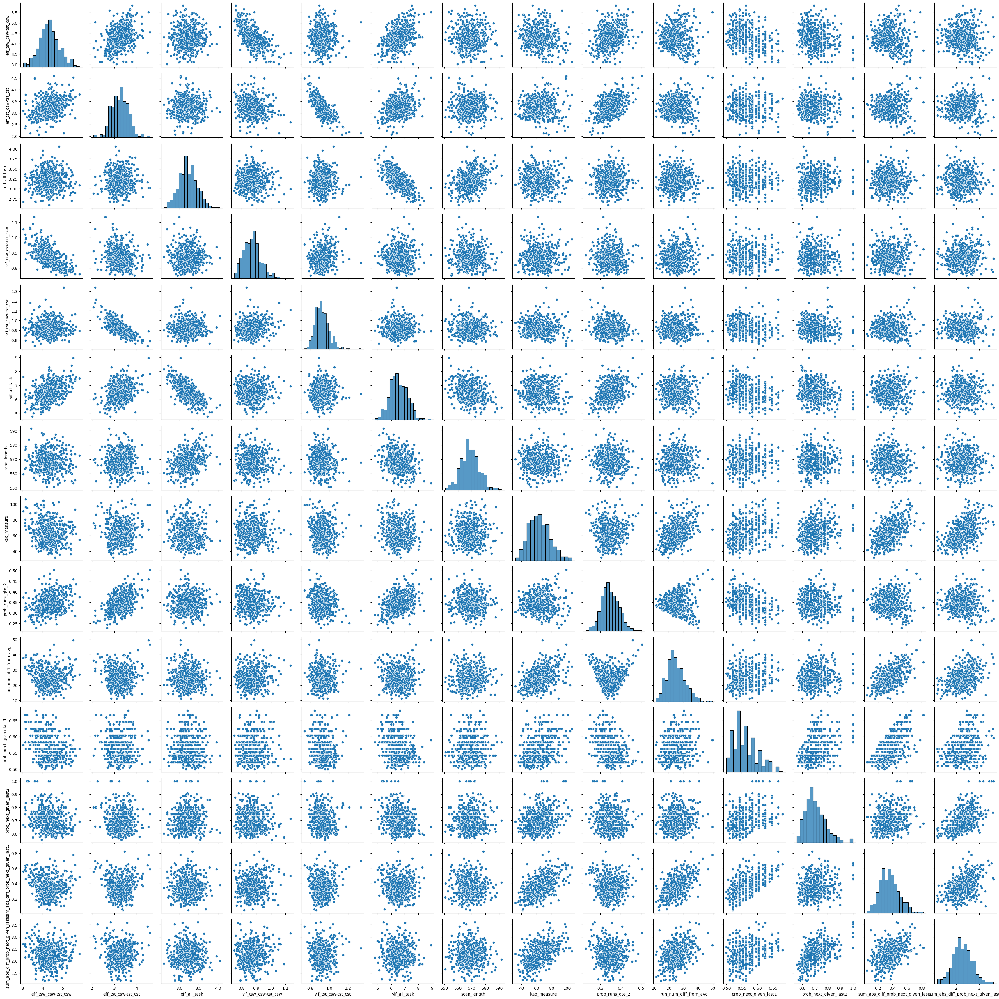

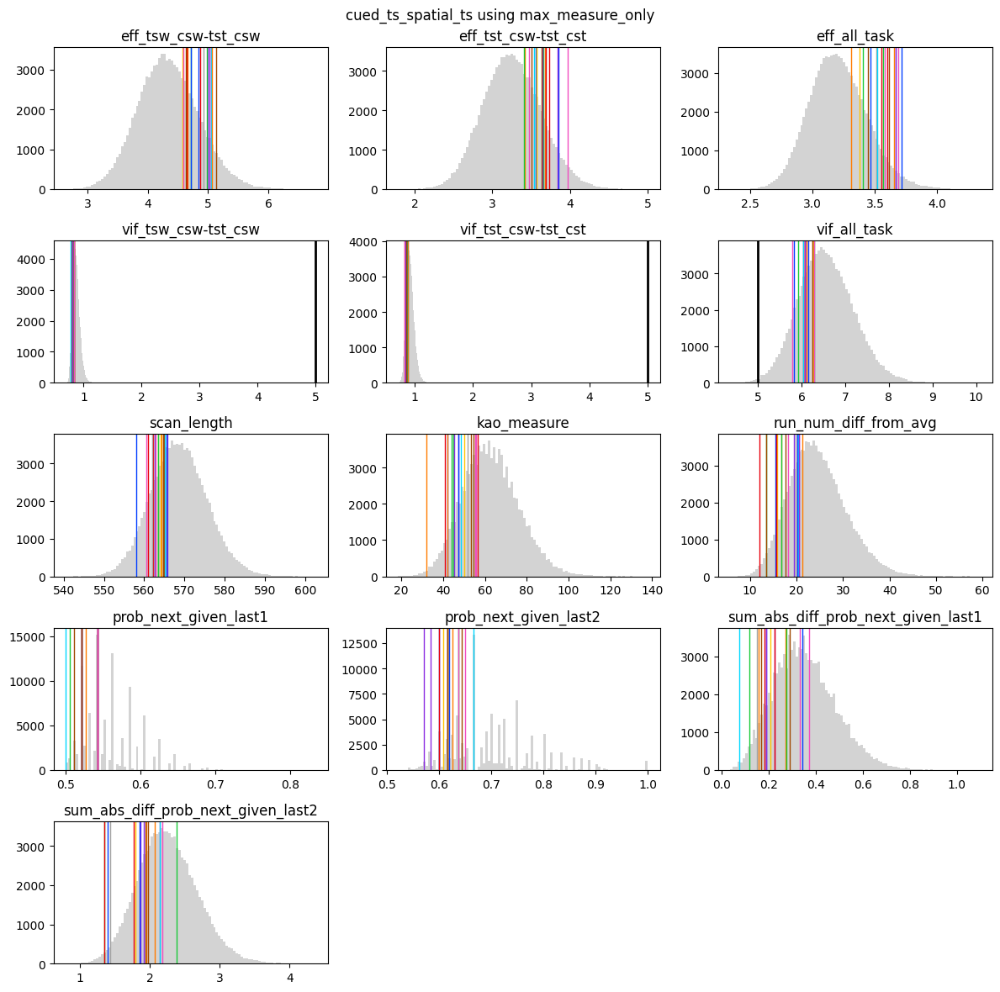

{59904, 22917, 44453, 30341, 70632, 22953, 1161, 25163, 33839, 34447, 32765, 7058, 44787, 31958, 74524, 80093, 98814}


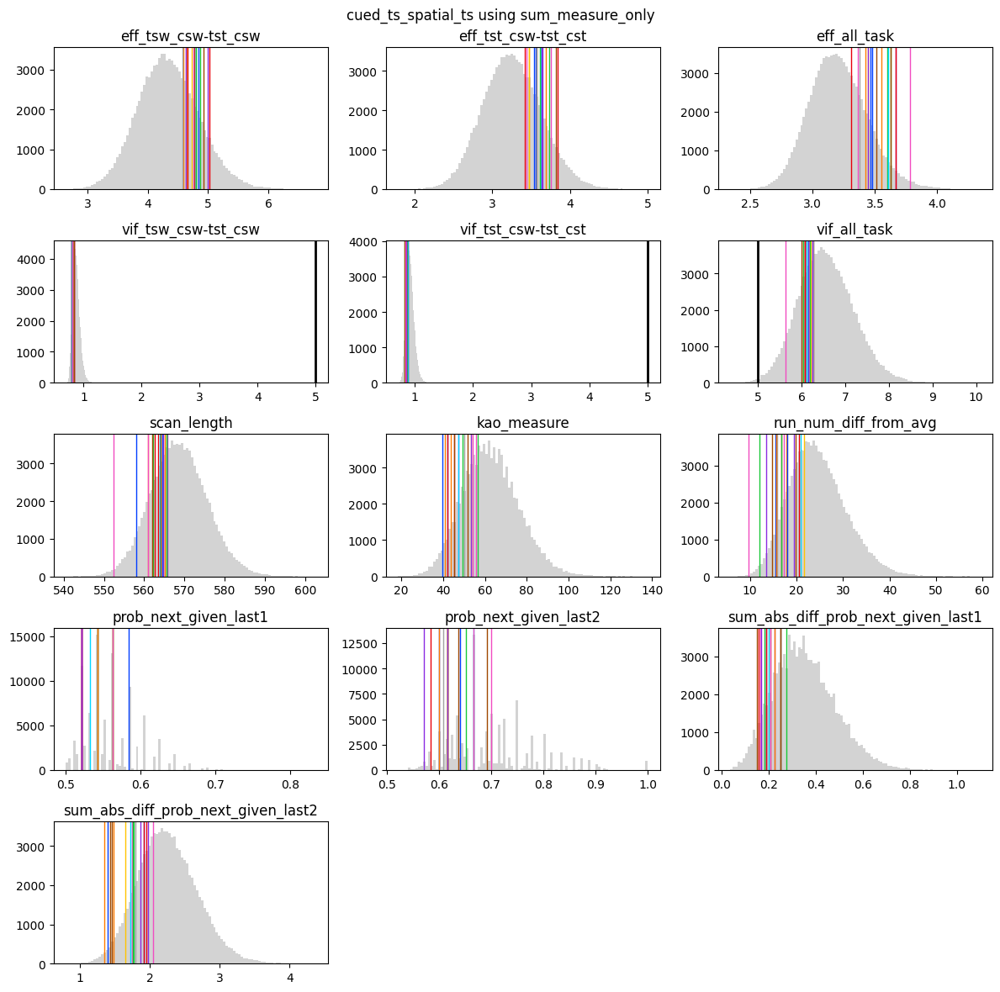

{59904, 80032, 30341, 22917, 70632, 25163, 62030, 33839, 42704, 2320, 7922, 31958, 6934, 74524, 80093, 10686, 46143}


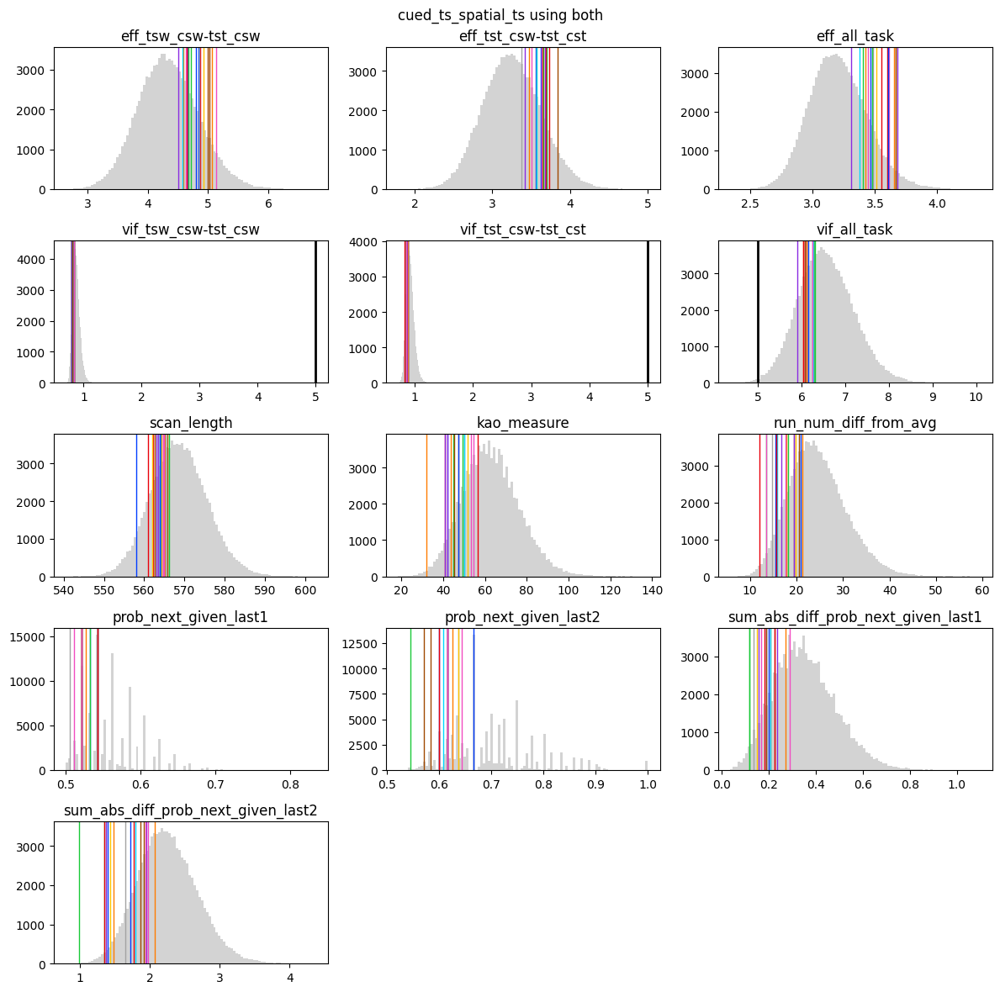

{59904, 80032, 44453, 30341, 22917, 70632, 22953, 53674, 25163, 33839, 2320, 7058, 53459, 31958, 87768, 74524, 80093}


In [30]:
task = 'cued_ts_spatial_ts'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_cued_ts_spatial_ts = {}
n_choose = 17

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_cued_ts_spatial_ts[choice] = choose_designs(
            output_cued_ts_spatial_ts,
            ranks_cued_ts_spatial_ts,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=True,
        )
    else:
        overlaps_cued_ts_spatial_ts[choice] = choose_designs(
            output_cued_ts_spatial_ts,
            ranks_cued_ts_spatial_ts,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [31]:
print(list(overlaps_cued_ts_spatial_ts['max_measure_only']))

[59904, 22917, 44453, 30341, 70632, 22953, 1161, 25163, 33839, 34447, 32765, 7058, 44787, 31958, 74524, 80093, 98814]


In [32]:
output_cued_ts_spatial_ts.loc[list(overlaps_cued_ts_spatial_ts['max_measure_only']), :]

,eff_tsw_csw-tst_csw,eff_tst_csw-tst_cst,eff_all_task,vif_tsw_csw-tst_csw,vif_tst_csw-tst_cst,vif_all_task,scan_length,kao_measure,prob_runs_gte_2,run_num_diff_from_avg,prob_next_given_last1,prob_next_given_last2,sum_abs_diff_prob_next_given_last1,sum_abs_diff_prob_next_given_last2
59904,4.843679,3.561730,3.463045,0.804127,0.854250,6.152401,558.110473,42.000,0.347107,15.5302,0.541667,0.600000,0.189188,1.399632
22917,4.663047,3.416174,3.311609,0.788907,0.864939,6.258889,563.506535,41.875,0.386555,16.6692,0.520833,0.615385,0.158496,1.952339
44453,4.717967,3.659213,3.402311,0.830212,0.859231,6.294328,563.478439,44.750,0.349593,13.5370,0.520833,0.615385,0.120143,1.355548
30341,4.869733,3.731645,3.595576,0.808010,0.827853,6.039350,562.247633,56.625,0.352459,12.0816,0.541667,0.615385,0.184406,1.771284
70632,4.990330,3.644936,3.663520,0.796547,0.881249,6.114041,565.650361,47.125,0.381356,19.4712,0.520833,0.571429,0.224585,1.868317
22953,5.133726,3.504606,3.613413,0.796971,0.865176,6.071056,564.830213,54.375,0.381356,17.6672,0.510638,0.642857,0.291167,1.945854
1161,5.048223,3.472302,3.684227,0.815813,0.859275,5.794748,560.546683,55.750,0.368852,20.4682,0.520833,0.650000,0.333840,2.143304
25163,4.922902,3.569647,3.508226,0.820003,0.874141,6.262693,561.913832,51.625,0.358333,19.8008,0.520833,0.636364,0.151542,1.437833
33839,4.576536,3.573691,3.376818,0.820768,0.856553,6.269158,563.986639,50.125,0.322581,15.8088,0.541667,0.608696,0.209412,1.799492
34447,5.045432,3.538940,3.515134,0.770675,0.849412,6.031600,565.191769,48.625,0.361345,20.3640,0.500000,0.666667,0.076882,2.149592


In [33]:
save_chosen_events_files(
    'cued_ts_spatial_ts',
    output_cued_ts_spatial_ts,
    events_cued_ts_spatial_ts,
    list(overlaps_cued_ts_spatial_ts['max_measure_only']),
    root,
)

## Nback

In [6]:
events_nback, output_nback, ranks_nback = get_events_eff_data(outdir, 'nback')
print(output_nback.shape)

(100000, 16)


In [7]:
# The VIF for 2back-1back are smaller for runs that start with 2back.  Since the VIFs for 2back-1back are all great, I'm omitting
# the VIFs for 2back-1back from the selection criteria to see if we get a better mix of designs starting with 1back and 2back

output_nback_no_vif_2vs1 = output_nback.drop(['vif_2back-1back', 'eff_2back-1back'], axis=1)

In [ ]:
task = 'nback'
base_psych_meas = ['scan_length']
choice = 'neither'
overlaps_nback = {}

overlaps_nback[choice] = choose_designs(
    output_nback_no_vif_2vs1,
    ranks_nback,
    choice,
    20,
    task,
    base_psych_meas,
    make_grid_plot=True,
)


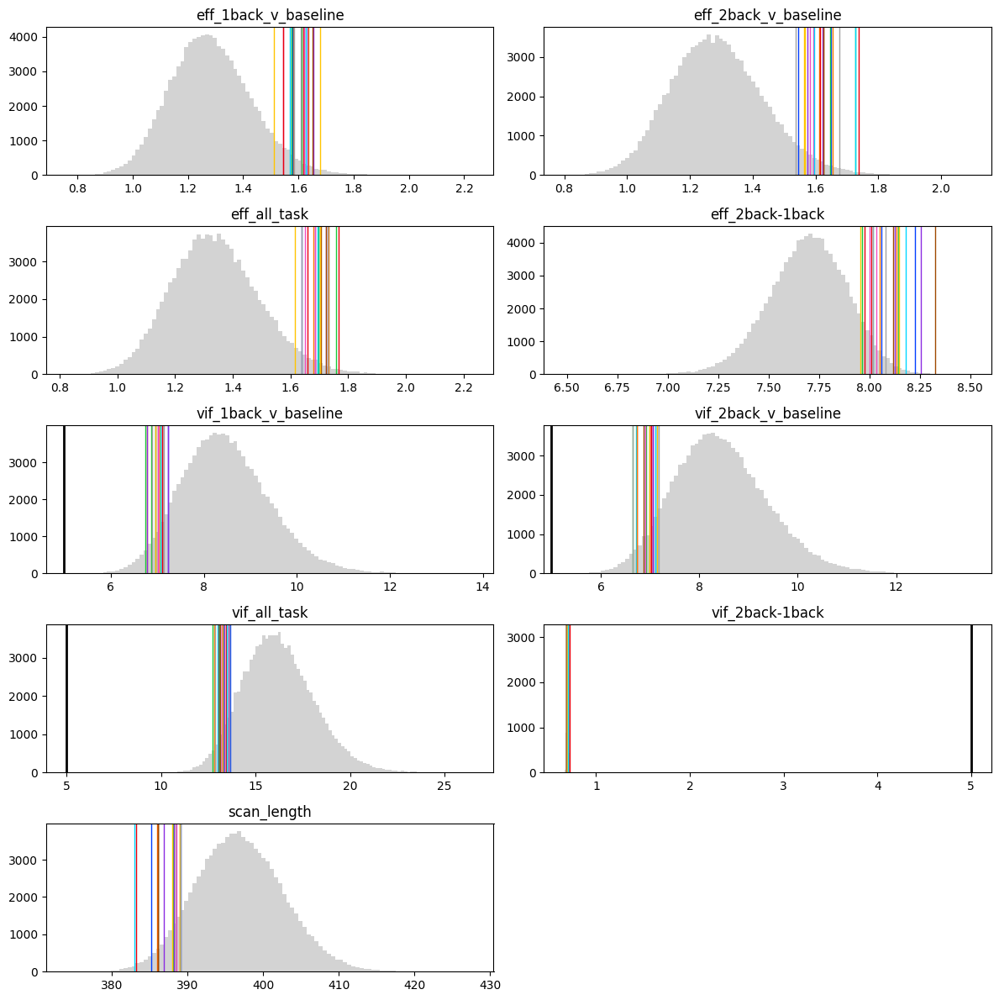

In [37]:
# Histograms with all variables
var1 = [var for var in output_nback.columns if 'vif' in var]
var2 = [var for var in output_nback.columns if 'eff' in var]
variables = var2 + var1 + ['scan_length']

n_rows = 5
n_cols = 2

draw_histograms(
    output_nback, overlaps_nback[choice], variables, n_rows, n_cols, title=None
)

In [38]:
save_chosen_events_files(
    'nback', output_nback, events_nback, list(overlaps_nback['neither']), root
)

## Span


In [3]:
events_span, output_span, ranks_span = get_events_eff_data(outdir, 'span')

In [4]:
print(output_span.shape)

(100000, 5)


In [5]:
ranks_span.keys()

dict_keys(['eff_recall vs baseline', 'eff_emc vs baseline', 'vif_recall vs baseline', 'vif_emc vs baseline', 'scan_length'])

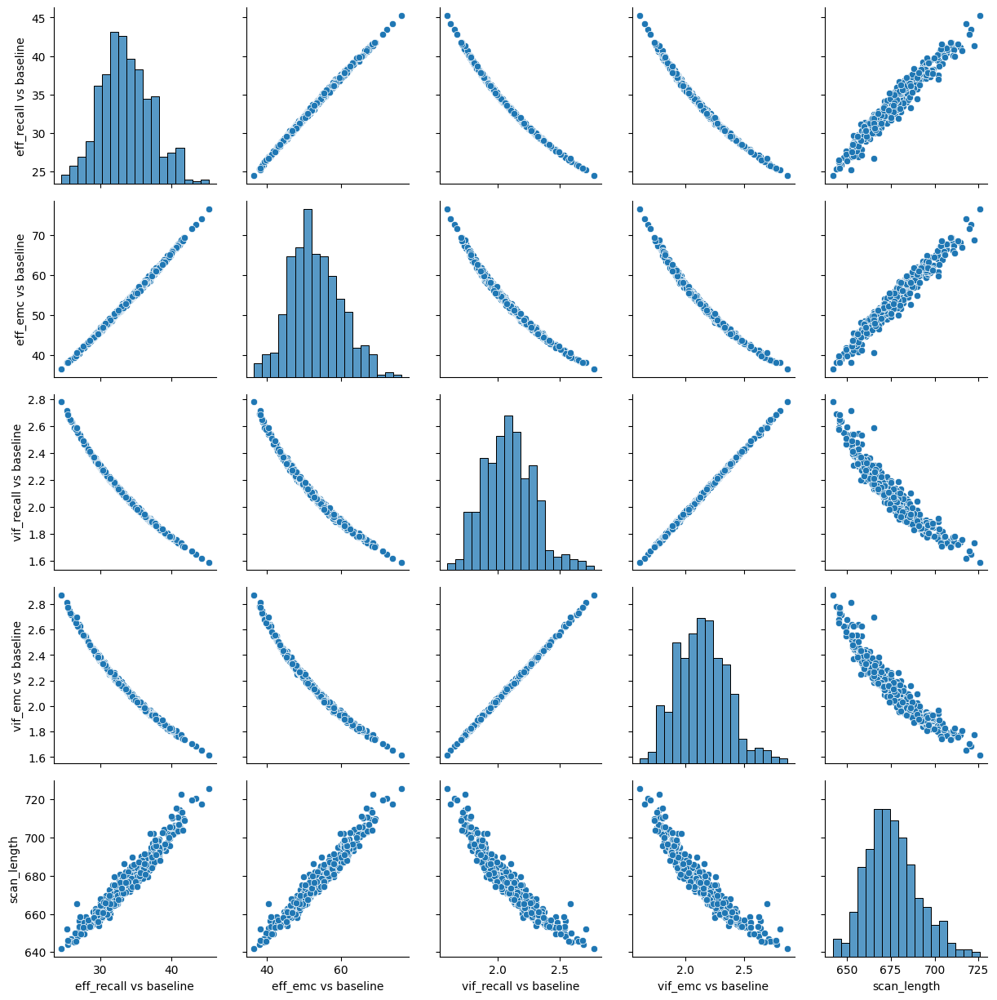

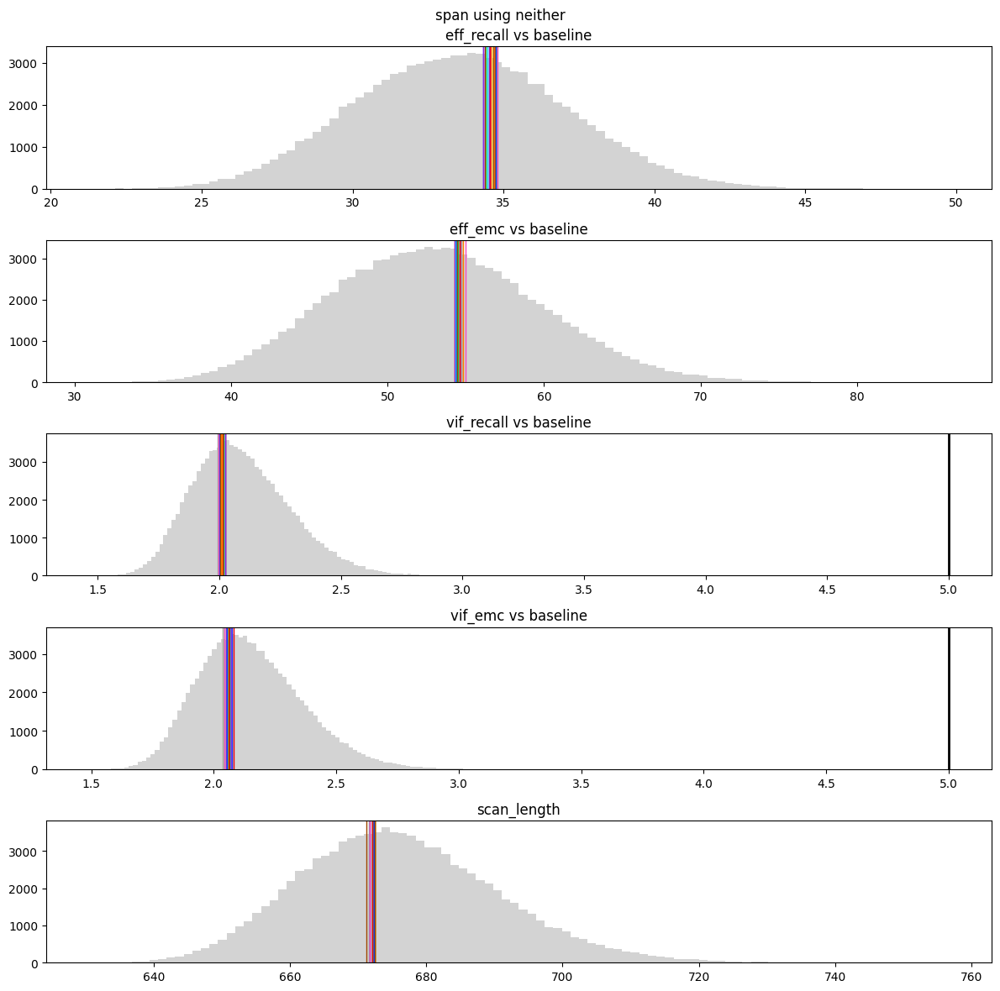

{65440, 42177, 1445, 50288, 63313, 16050, 7857, 98932, 48475, 19613, 69398, 10297, 68602, 92411, 64317, 17118, 32863}


In [10]:
task = 'span'
base_psych_meas = ['scan_length']
choice = 'neither'
overlaps_span = {}
n_choose = 17
overlaps_span[choice] = choose_designs(
    output_span,
    ranks_span,
    choice,
    n_choose,
    task,
    base_psych_meas,
    make_grid_plot=True,
)


In [11]:
save_chosen_events_files(
    'span', output_span, events_span, list(overlaps_span['neither']), root
)

## Spatial Cueing

In [44]:
events_spatial_cueing, output_spatial_cueing, ranks_spatial_cueing = (
    get_events_eff_data(outdir, 'spatial_cueing')
)
print(output_spatial_cueing.shape)

(100000, 16)


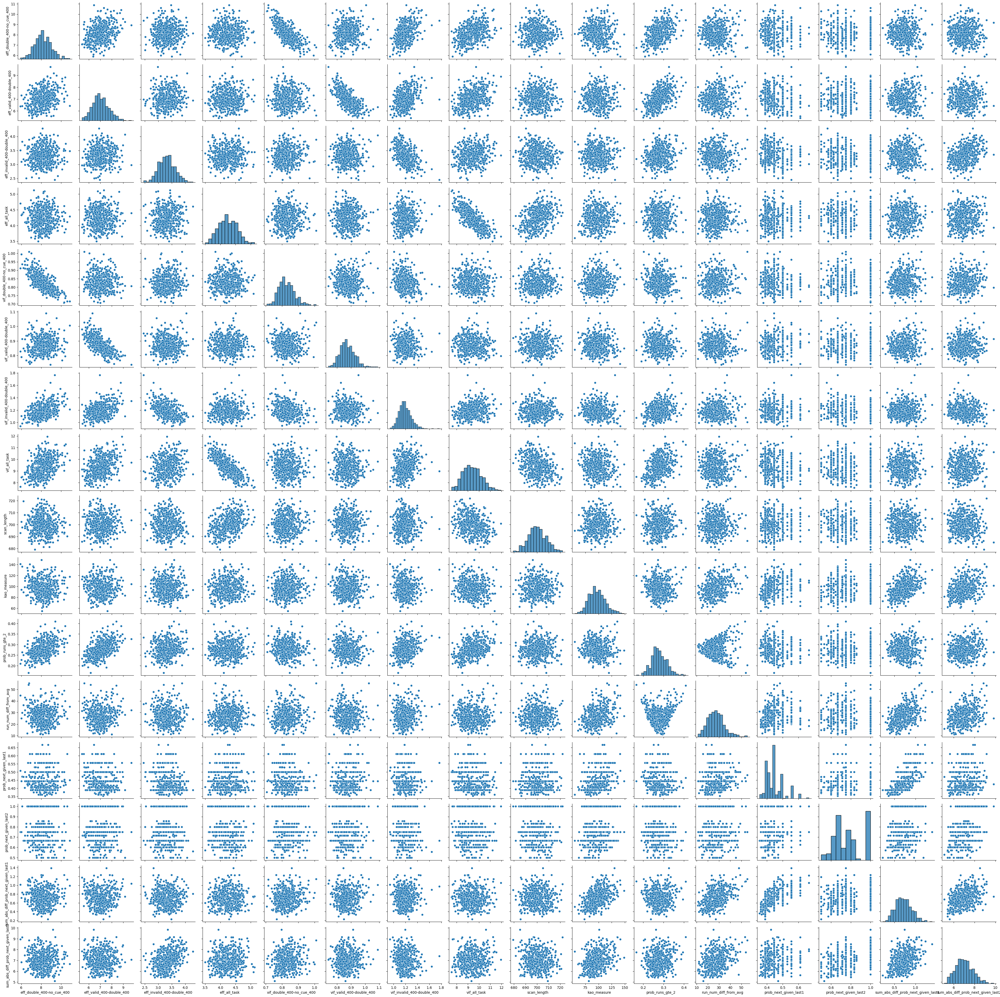

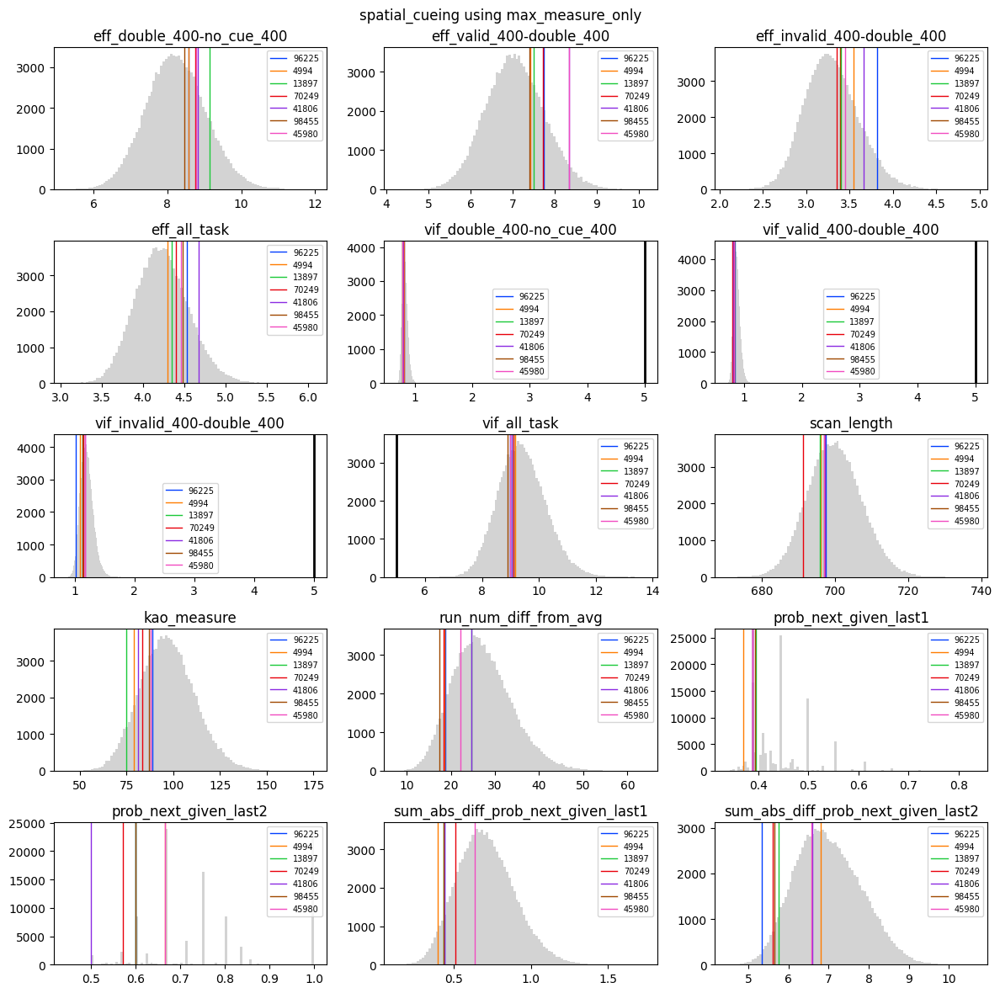

{96225, 4994, 13897, 70249, 41806, 98455, 45980}


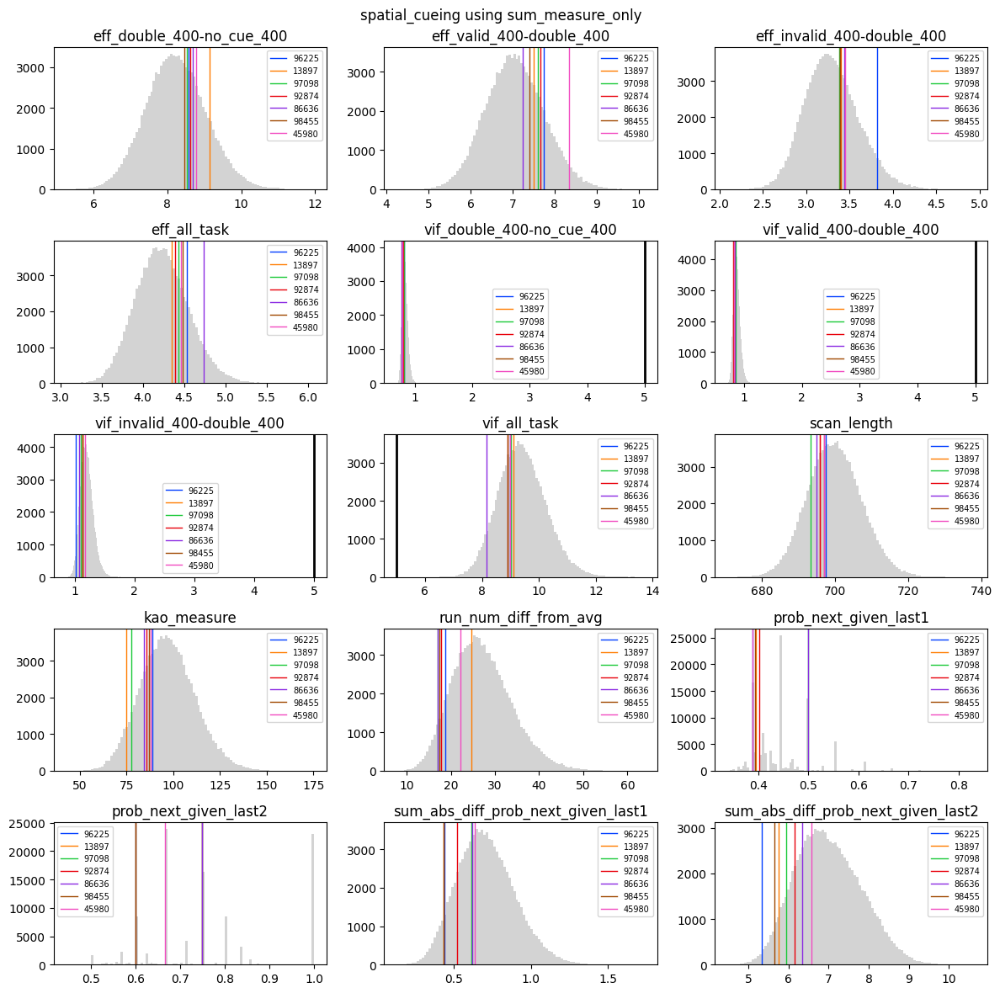

{96225, 13897, 97098, 92874, 86636, 98455, 45980}


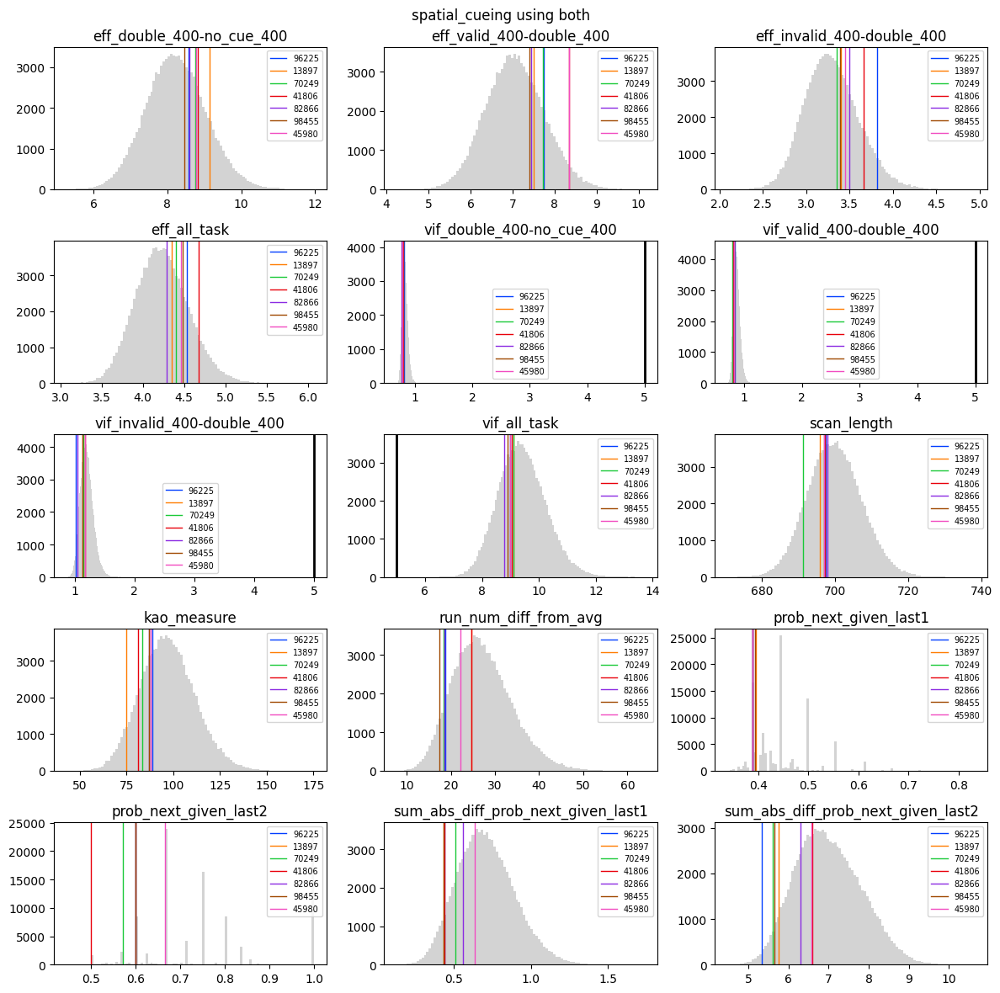

{96225, 13897, 70249, 41806, 82866, 98455, 45980}


In [45]:
task = 'spatial_cueing'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_spatial_cueing = {}
n_choose = 7

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_spatial_cueing[choice] = choose_designs(
            output_spatial_cueing,
            ranks_spatial_cueing,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=True,
        )
    else:
        overlaps_spatial_cueing[choice] = choose_designs(
            output_spatial_cueing,
            ranks_spatial_cueing,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [46]:
save_chosen_events_files(
    'spatial_cueing',
    output_spatial_cueing,
    events_spatial_cueing,
    list(overlaps_spatial_cueing['max_measure_only']),
    root,
)

## Visual Search

In [47]:
events_visual_search, output_visual_search, ranks_visual_search = get_events_eff_data(
    outdir, 'visual_search'
)
print(output_visual_search.shape)

(100000, 14)


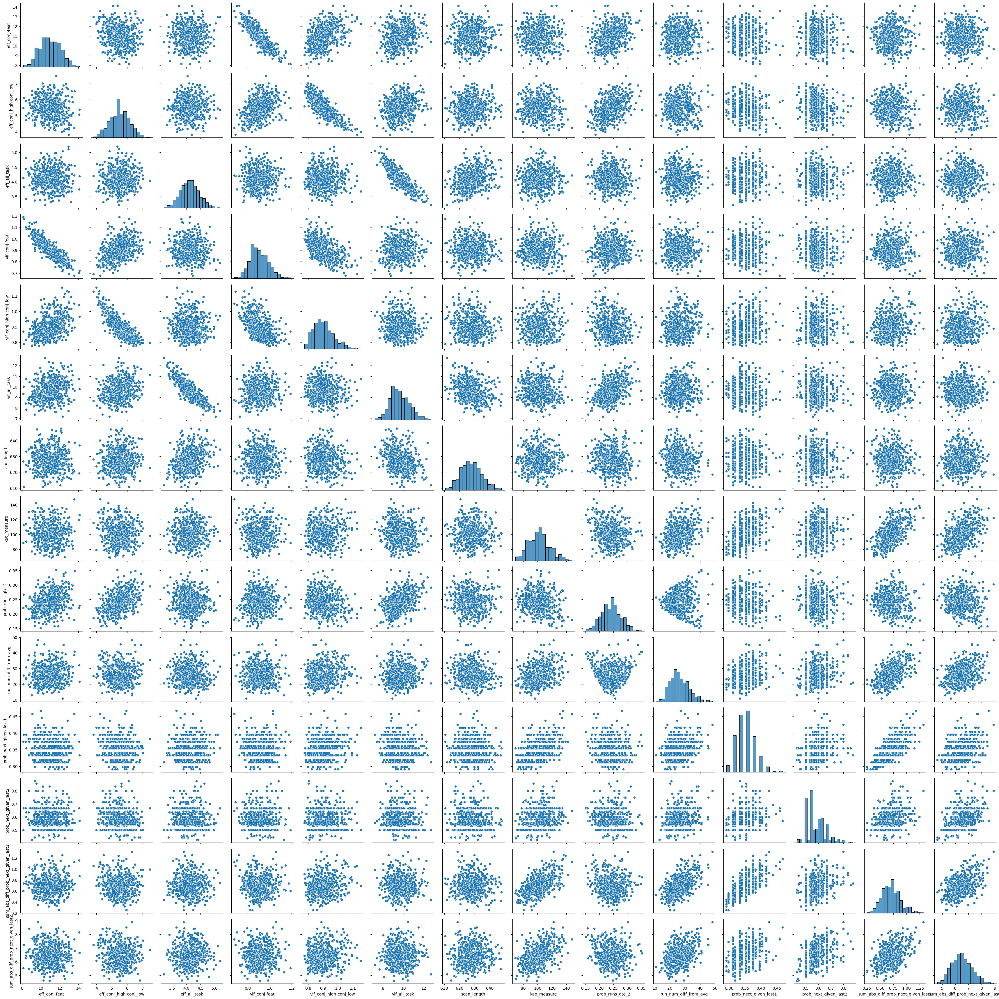

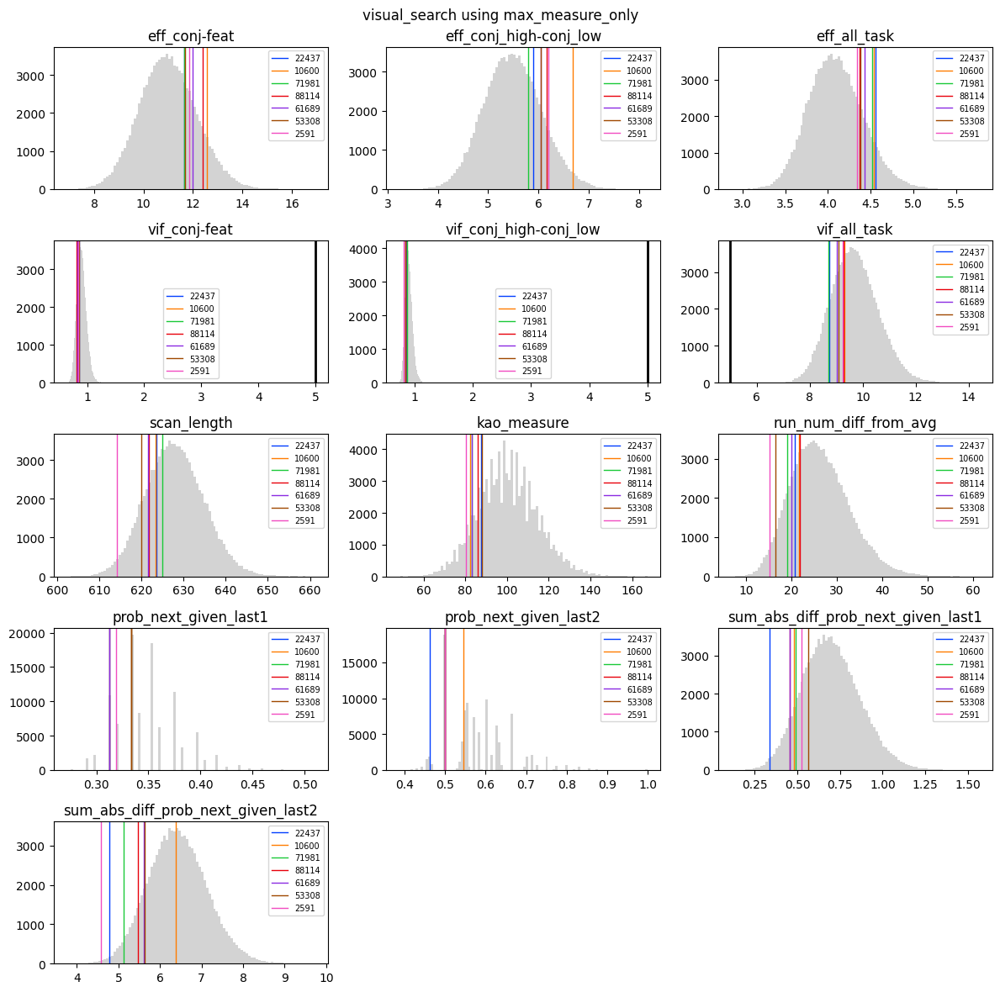

{22437, 10600, 71981, 88114, 61689, 53308, 2591}


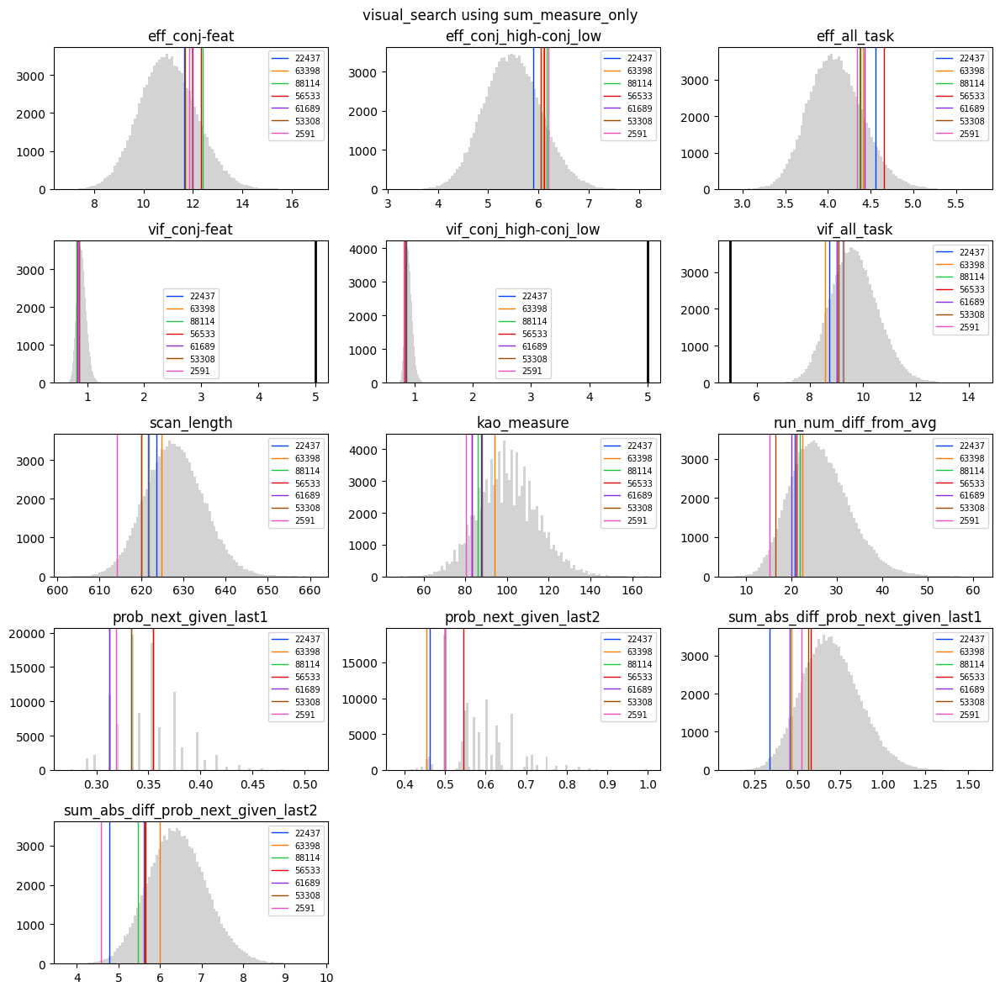

{22437, 63398, 88114, 56533, 61689, 53308, 2591}


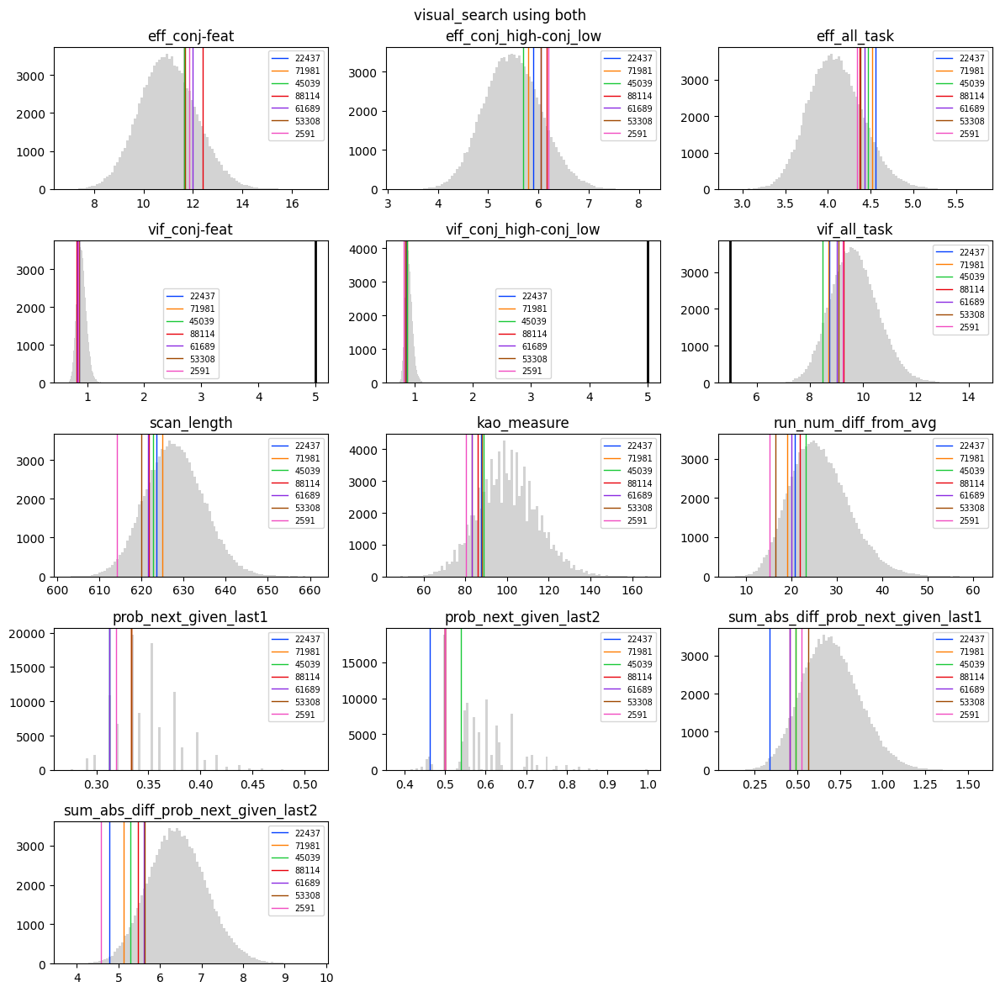

{22437, 71981, 45039, 88114, 61689, 53308, 2591}


In [48]:
task = 'visual_search'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_visual_search = {}
n_choose = 7

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_visual_search[choice] = choose_designs(
            output_visual_search,
            ranks_visual_search,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=True,
        )
    else:
        overlaps_visual_search[choice] = choose_designs(
            output_visual_search,
            ranks_visual_search,
            choice,
            n_choose,
            task,
            base_psych_meas,
            make_grid_plot=False,
        )

In [49]:
save_chosen_events_files(
    'visual_search',
    output_visual_search,
    events_visual_search,
    list(overlaps_visual_search['max_measure_only']),
    root,
)